https://wybory.gov.pl/prezydent20200628/pl/dane_w_arkuszach

https://blog.prokulski.science/index.php/2020/07/19/wyniki-wyborow-prezydenckich-2020-cos-wiecej-niz-mapki/

https://blog.prokulski.science/index.php/2020/02/28/mapy-w-pythonie/

https://bdl.stat.gov.pl/BDL/metadane/cechy/2137

https://bdl.stat.gov.pl/BDL/metadane/cechy/1944

https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html

In [1]:
import os
import csv
from io import BytesIO
from io import TextIOWrapper
from zipfile import ZipFile
from urllib.request import urlopen
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
import folium
import numpy as np
import seaborn as sns
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
pd.options.display.max_columns = None

In [2]:
def get_current_working_directory():
        """
        :return:
        """
        current_path = os.getcwd()

        print("\n" + "Current Working Directory Set As: " + str(current_path) + "\n")

        return current_path

In [3]:
def change_current_working_directory(directory):
        """
        :param directory:
        :return:
        """
        if os.path.exists(directory):
            os.chdir(directory)
            print("\n" + "Working Directory Changed To: " + str(directory) + "\n")
        else:
            print("\n" + "Directory Does Not Exists. Working Directory Have Not Been Changed." + "\n")

        return str(os.getcwd())

In [4]:
def create_new_working_directory(directory):
    """
    :param directory:
    :return:
    """
    if os.path.exists(directory):
        print("\n" + "Directory: " + str(directory) + " Already Exists." + "\n")
    else:
        os.mkdir(directory)
        print("\n" + "New Directory Created: " + str(directory) + "\n")

In [5]:
def get_in_memory_data(url,file_name):
    zip_files = []
    resp = urlopen(url)
    with ZipFile(BytesIO(resp.read())) as zf:
        with zf.open(file_name, 'r') as infile:
            df = pd.read_csv(zf.open(file_name), delimiter=";")
            
    return df

In [6]:
def get_in_memory_data(url):
    zip_files = []
    resp = urlopen(url)
    with ZipFile(BytesIO(resp.read())) as zf:
        text_files = zf.infolist()
        for text_file in text_files:
            with zf.open(text_file, 'r') as infile:
                df = pd.read_csv(zf.open(text_file.filename), delimiter=";")
            
    return df

In [7]:
def get_list_of_files_from_directory(directory):
    """
    :param directory:
    :return:
    """
    list_of_files = []

    for item in os.listdir(directory):
        list_of_files.append(item)

    print("\n" + "List Of Files: " + str(list_of_files) + "\n" + "From Directory: " + str(directory) + "\n")

    return list_of_files

In [8]:
def df_to_csv(object_name, directory, csv_file_name):
    """
    :param object_name:
    :param directory:
    :param csv_file_name:
    :return:
    """
    #object_name = object_name.reset_index(inplace=True)
    object_name.to_csv(directory + csv_file_name + ".csv", header=True, index=False)

    print("\n" + str(csv_file_name) + ".csv Written Under Directory: " + str(directory) + "\n")

In [9]:
change_current_working_directory("C:\\Users\\KonuTech\\Downloads")


Working Directory Changed To: C:\Users\KonuTech\Downloads



'C:\\Users\\KonuTech\\Downloads'

In [10]:
create_new_working_directory(directory=get_current_working_directory() + "\\election\\")


Current Working Directory Set As: C:\Users\KonuTech\Downloads


Directory: C:\Users\KonuTech\Downloads\election\ Already Exists.



In [11]:
change_current_working_directory(get_current_working_directory() + "\\election\\")


Current Working Directory Set As: C:\Users\KonuTech\Downloads


Working Directory Changed To: C:\Users\KonuTech\Downloads\election\



'C:\\Users\\KonuTech\\Downloads\\election'

In [12]:
get_current_working_directory()


Current Working Directory Set As: C:\Users\KonuTech\Downloads\election



'C:\\Users\\KonuTech\\Downloads\\election'

# Candidates of FIRST round

In [13]:
candidates_of_first_round = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/kandydaci_csv.zip")
candidates_of_first_round = candidates_of_first_round.set_index('Nazwisko')
candidates_of_first_round.head(3)

,Pozycja na karcie,Imiona,Płeć,Wiek,Wykształcenie,Zawód,Miejsce pracy,Miejsce zamieszkania,Przynależność do partii,Nazwa komitetu,Sygnatura,TERYT m. z.,Gmina m.z.,Liczba głosów,Procent wszystkich głosów,Wybrany,Druga tura
Nazwisko,,,,,,,,,,,,,,,,,
BIEDROŃ,1,Robert,Mężczyzna,44,wyższe politologiczne,poseł do Parlamentu Europejskiego,NaN,Warszawa,członek partii politycznej: Wiosna Roberta Bie...,KOMITET WYBORCZY KANDYDATA NA PREZYDENTA RZECZ...,ZPOW-6020-6/20,146501,Warszawa,432129,"2,22",Nie,Nie
BOSAK,2,Krzysztof,Mężczyzna,38,średnie,poseł na Sejm Rzeczypospolitej Polskiej,NaN,Warszawa,członek partii politycznej: Konfederacja Wolno...,KOMITET WYBORCZY KANDYDATA NA PREZYDENTA RZECZ...,ZPOW-6020-1/20,146501,Warszawa,1317380,"6,78",Nie,Nie
DUDA,3,Andrzej Sebastian,Mężczyzna,48,wyższe prawnicze,Prezydent Rzeczypospolitej Polskiej,NaN,Kraków,nie należy do partii politycznej,KOMITET WYBORCZY KANDYDATA NA PREZYDENTA RZECZ...,ZPOW-6020-5/20,126101,m. Kraków,8450513,"43,50",Nie,Tak


In [14]:
candidates_of_first_round['Procent wszystkich głosów'] = candidates_of_first_round['Procent wszystkich głosów'].apply(lambda x: x.replace(',','.'))
candidates_of_first_round['Procent wszystkich głosów'] = pd.to_numeric(candidates_of_first_round['Procent wszystkich głosów'],errors='coerce')
candidates_of_first_round.sort_values('Procent wszystkich głosów',inplace=True)

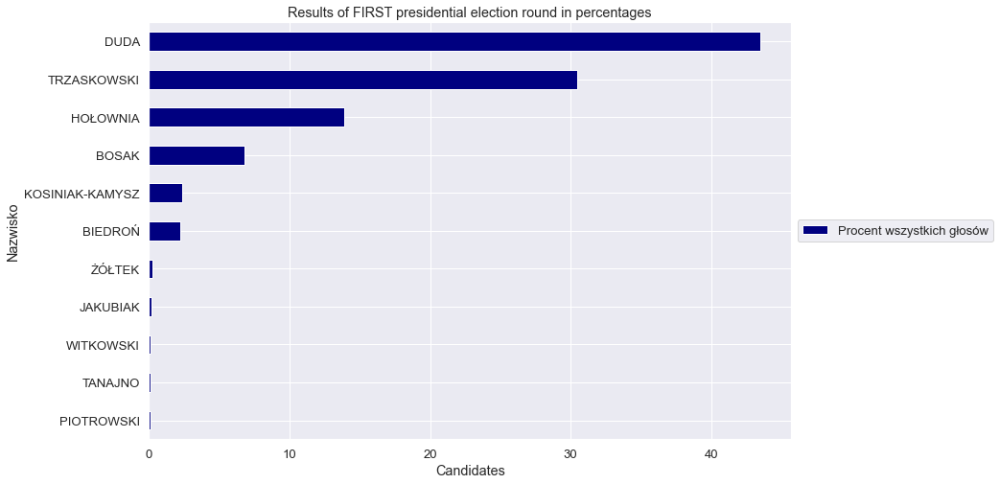

In [15]:
sns.set(font_scale=1.2)
candidates_of_first_round["Procent wszystkich głosów"].plot(kind='barh', stacked=True, colormap='jet', figsize=(12,8)).legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.title("Results of FIRST presidential election round in percentages")
plt.xlabel("Candidates")
plt.show()

# Voting wards after the FIRST round of elections

In [16]:
voting_wards_after_the_first_round_of_elections = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/obwody_glosowania_csv.zip")
voting_wards_after_the_first_round_of_elections.head(3)

,Nr OKW,TERYT gminy,Gmina,Powiat,Numer,Mieszkańcy,Wyborcy,Siedziba,Miejscowość,Ulica,Numer posesji,Numer lokalu,Kod pocztowy,Poczta,Typ obwodu,Przystosowany dla niepełnosprawnych,Typ obszaru,Pełna siedziba,Opis granic
0,15,100108,gm. Zelów,bełchatowski,10,0,50,Dom Pomocy Społecznej,Zabłoty,NaN,19,NaN,97-425,Zelów,dom pomocy społecznej,Nie,wieś,"Dom Pomocy Społecznej, Zabłoty 19, 97-425 Zelów",Dom Pomocy Społecznej w Zabłotach
1,49,321301,m. Darłowo,sławieński,4,1616,1348,"Niepubliczne Przedszkole ""Jacek i Agatka""",Darłowo,ul. Zamkowa,6,NaN,76-150,Darłowo,stały,Nie,miasto,"Niepubliczne Przedszkole ""Jacek i Agatka"", ul....","Ulice: Króla Eryka Pomorskiego, Henryka Wienia..."
2,13,80602,gm. Drezdenko,strzelecko-drezdenecki,10,1464,1174,Sala Wiejska w miejscowości Trzebicz,Trzebicz,Mostowa,3,NaN,66-530,Drezdenko,stały,Tak,wieś,"Sala Wiejska w miejscowości Trzebicz, Trzebicz...","Gmina Drezdenko, sołectwa: Bagniewo, Osów, Trz..."


# Composition of precinct election commissions in the FIRST round of elections

In [17]:
composition_of_precinct_election_commissions_in_the_first_round_of_elections = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/sklad_komisji_obwodowych_csv.zip")
composition_of_precinct_election_commissions_in_the_first_round_of_elections.head(3)

,TERYT gminy,Nazwa gminy,Powiat,Nr obw.,Nazwisko,Imiona,Funkcja
0,20101,m. Bolesławiec,bolesławiecki,1,Glinicka-Grabowy,Marta Anna,Przewodniczący
1,20101,m. Bolesławiec,bolesławiecki,1,Kowalczyk,Alicja Rozalia,Zastępca Przewodniczącego
2,20101,m. Bolesławiec,bolesławiecki,1,Mikołajewska,Marzena Monika,Członek


# Results of voting for candidates in the FIRST round of elections - by precincts

In [18]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_by_precincts = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/wyniki_gl_na_kand_po_obwodach_csv.zip")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_by_precincts.head(3)

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3249: DtypeWarning: Columns (11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43) have mixed types. Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


,Symbol kontrolny,Nr OKW,Kod TERYT,Typ gminy,Numer obwodu,Typ obszaru,Typ obwodu,Siedziba,Gmina,Powiat,Województwo,Komisje obwodowe otrzymały kart do głosowania,Liczba wyborców uprawnionych do głosowania,Nie wykorzystano kart do głosowania,"Liczba wyborców, którym wydano karty do głosowania",Liczba wyborców głosujących przez pełnomocnika,Liczba wyborców głosujących na podstawie zaświadczenia o prawie do głosowania,"Liczba wyborców, którym wysłano pakiety wyborcze",Liczba otrzymanych kopert zwrotnych,"Liczba kopert zwrotnych, w których nie było oświadczenia o osobistym i tajnym oddaniu głosu","Liczba kopert zwrotnych, w których oświadczenie nie było podpisane","Liczba kopert zwrotnych, w których nie było koperty na kartę do głosowania","Liczba kopert zwrotnych, w których znajdowała się niezaklejona koperta na kartę do głosowania",Liczba kopert na kartę do głosowania wrzuconych do urny,Liczba kart wyjętych z urny,W tym liczba kart wyjętych z kopert na kartę do głosowania,Liczba kart nieważnych,Liczba kart ważnych,Liczba głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,Liczba głosów ważnych oddanych łącznie na wszystkich kandydatów,Robert BIEDROŃ,Krzysztof BOSAK,Andrzej Sebastian DUDA,Szymon Franciszek HOŁOWNIA,Marek JAKUBIAK,Władysław Marcin KOSINIAK-KAMYSZ,Mirosław Mariusz PIOTROWSKI,Paweł Jan TANAJNO,Rafał Kazimierz TRZASKOWSKI,Waldemar Włodzimierz WITKOWSKI,Stanisław Józef ŻÓŁTEK
0,9924-e2c7-444e-4601-e5ef-60b9-f73d-d8ba,2.0,20101.0,gmina miejska,1,miasto,stały,"Szkoła Podstawowa Nr 3, ul. Ceramiczna 5, 59-7...",m. Bolesławiec,bolesławiecki,dolnośląskie,1432,1553,455,977,0,4,6,6,0,0,0,0,6,983,6,0,983,1,0,1,0,982,19,70,367,164,2,15,1,3,338,1,2
1,9219-f878-5ef7-3ad1-a3c7-d301-7c41-1eed,2.0,20101.0,gmina miejska,2,miasto,stały,"Szkoła Podstawowa Nr 3, ul. Ceramiczna 5, 59-7...",m. Bolesławiec,bolesławiecki,dolnośląskie,1239,1346,330,909,0,5,10,10,0,0,0,0,10,919,10,0,919,0,0,0,0,919,17,62,311,136,2,15,3,3,365,1,4
2,d0a4-75ae-b6b2-687c-05c7-7425-1924-887c,2.0,20101.0,gmina miejska,3,miasto,stały,"Szkoła Podstawowa Nr 5, ul. Dolne Młyny 60, 59...",m. Bolesławiec,bolesławiecki,dolnośląskie,1256,1414,358,898,0,5,6,6,0,0,0,0,6,904,6,0,904,2,0,2,0,902,19,66,326,176,0,9,0,0,300,1,5


# Results of voting for candidates in the FIRST round of elections - percentage by precincts

In [19]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_precincts = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/wyniki_gl_na_kand_po_obwodach_proc_csv.zip")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_precincts.head(3)

,Symbol kontrolny,Nr OKW,Kod TERYT,Typ gminy,Numer obwodu,Typ obszaru,Typ obwodu,Siedziba,Gmina,Powiat,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Robert BIEDROŃ,Krzysztof BOSAK,Andrzej Sebastian DUDA,Szymon Franciszek HOŁOWNIA,Marek JAKUBIAK,Władysław Marcin KOSINIAK-KAMYSZ,Mirosław Mariusz PIOTROWSKI,Paweł Jan TANAJNO,Rafał Kazimierz TRZASKOWSKI,Waldemar Włodzimierz WITKOWSKI,Stanisław Józef ŻÓŁTEK
0,9924-e2c7-444e-4601-e5ef-60b9-f73d-d8ba,2.0,20101.0,gmina miejska,1,miasto,stały,"Szkoła Podstawowa Nr 3, ul. Ceramiczna 5, 59-7...",m. Bolesławiec,bolesławiecki,dolnośląskie,"63,30","0,10","0,00","100,00","0,00","99,90","1,93","7,13","37,37","16,70","0,20","1,53","0,10","0,31","34,42","0,10","0,20"
1,9219-f878-5ef7-3ad1-a3c7-d301-7c41-1eed,2.0,20101.0,gmina miejska,2,miasto,stały,"Szkoła Podstawowa Nr 3, ul. Ceramiczna 5, 59-7...",m. Bolesławiec,bolesławiecki,dolnośląskie,"68,28","0,00",NaN,NaN,NaN,"100,00","1,85","6,75","33,84","14,80","0,22","1,63","0,33","0,33","39,72","0,11","0,44"
2,d0a4-75ae-b6b2-687c-05c7-7425-1924-887c,2.0,20101.0,gmina miejska,3,miasto,stały,"Szkoła Podstawowa Nr 5, ul. Dolne Młyny 60, 59...",m. Bolesławiec,bolesławiecki,dolnośląskie,"63,93","0,22","0,00","100,00","0,00","99,78","2,11","7,32","36,14","19,51","0,00","1,00","0,00","0,00","33,26","0,11","0,55"


# Results of voting for candidates in the FIRST round of elections - by communes

In [20]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_by_communes = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/wyniki_gl_na_kand_po_gminach_csv.zip")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_by_communes.head(3)

,Nr OKW,Kod TERYT,Rodzaj jednostki,Gmina,Powiat,Województwo,Komisje obwodowe otrzymały kart do głosowania,Liczba wyborców uprawnionych do głosowania,Nie wykorzystano kart do głosowania,"Liczba wyborców, którym wydano karty do głosowania",Liczba wyborców głosujących przez pełnomocnika,Liczba wyborców głosujących na podstawie zaświadczenia o prawie do głosowania,"Liczba wyborców, którym wysłano pakiety wyborcze",Liczba otrzymanych kopert zwrotnych,"Liczba kopert zwrotnych, w których nie było oświadczenia o osobistym i tajnym oddaniu głosu","Liczba kopert zwrotnych, w których oświadczenie nie było podpisane","Liczba kopert zwrotnych, w których nie było koperty na kartę do głosowania","Liczba kopert zwrotnych, w których znajdowała się niezaklejona koperta na kartę do głosowania",Liczba kopert na kartę do głosowania wrzuconych do urny,Liczba kart wyjętych z urny,W tym liczba kart wyjętych z kopert na kartę do głosowania,Liczba kart nieważnych,Liczba kart ważnych,Liczba głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,Liczba głosów ważnych oddanych łącznie na wszystkich kandydatów,Robert BIEDROŃ,Krzysztof BOSAK,Andrzej Sebastian DUDA,Szymon Franciszek HOŁOWNIA,Marek JAKUBIAK,Władysław Marcin KOSINIAK-KAMYSZ,Mirosław Mariusz PIOTROWSKI,Paweł Jan TANAJNO,Rafał Kazimierz TRZASKOWSKI,Waldemar Włodzimierz WITKOWSKI,Stanisław Józef ŻÓŁTEK,Liczba obwodów
0,2,20101,gmina miejska,m. Bolesławiec,bolesławiecki,dolnośląskie,27641,29513,9246,18395,1,126,189,185,3,0,0,0,182,18574,182,7,18567,53,19,34,0,18514,450,1131,6465,2899,32,255,13,19,7183,24,43,23
1,2,20102,gmina wiejska,gm. Bolesławiec,bolesławiecki,dolnośląskie,10296,11184,3354,6942,3,27,13,13,0,0,0,1,12,6954,12,0,6954,28,10,18,0,6926,132,506,2889,1217,7,118,8,5,2016,8,20,11
2,2,20103,gmina wiejska,gm. Gromadka,bolesławiecki,dolnośląskie,4056,4302,1592,2464,3,10,10,9,0,0,0,0,9,2473,9,0,2473,12,4,8,0,2461,45,159,1365,261,3,54,0,4,561,3,6,4


# Results of voting for candidates in the FIRST round of elections - percentage by communes

In [21]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_communes = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/wyniki_gl_na_kand_po_gminach_proc_csv.zip")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_communes.head(3)

,Nr OKW,Kod TERYT,Rodzaj jednostki,Gmina,Powiat,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Robert BIEDROŃ,Krzysztof BOSAK,Andrzej Sebastian DUDA,Szymon Franciszek HOŁOWNIA,Marek JAKUBIAK,Władysław Marcin KOSINIAK-KAMYSZ,Mirosław Mariusz PIOTROWSKI,Paweł Jan TANAJNO,Rafał Kazimierz TRZASKOWSKI,Waldemar Włodzimierz WITKOWSKI,Stanisław Józef ŻÓŁTEK,Liczba obwodów
0,2,20101,gmina miejska,m. Bolesławiec,bolesławiecki,dolnośląskie,"62,91","0,29","35,85","64,15","0,00","99,71","2,43","6,11","34,92","15,66","0,17","1,38","0,07","0,10","38,80","0,13","0,23",23
1,2,20102,gmina wiejska,gm. Bolesławiec,bolesławiecki,dolnośląskie,"62,18","0,40","35,71","64,29","0,00","99,60","1,91","7,31","41,71","17,57","0,10","1,70","0,12","0,07","29,11","0,12","0,29",11
2,2,20103,gmina wiejska,gm. Gromadka,bolesławiecki,dolnośląskie,"57,48","0,49","33,33","66,67","0,00","99,51","1,83","6,46","55,47","10,61","0,12","2,19","0,00","0,16","22,80","0,12","0,24",4


# Results of voting for candidates in the FIRST round of elections - by poviats

In [22]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_by_poviats = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/wyniki_gl_na_kand_po_powiatach_csv.zip")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_by_poviats.head(3)

,Nr OKW,Kod TERYT,Powiat,Województwo,Komisje obwodowe otrzymały kart do głosowania,Liczba wyborców uprawnionych do głosowania,Nie wykorzystano kart do głosowania,"Liczba wyborców, którym wydano karty do głosowania",Liczba wyborców głosujących przez pełnomocnika,Liczba wyborców głosujących na podstawie zaświadczenia o prawie do głosowania,"Liczba wyborców, którym wysłano pakiety wyborcze",Liczba otrzymanych kopert zwrotnych,"Liczba kopert zwrotnych, w których nie było oświadczenia o osobistym i tajnym oddaniu głosu","Liczba kopert zwrotnych, w których oświadczenie nie było podpisane","Liczba kopert zwrotnych, w których nie było koperty na kartę do głosowania","Liczba kopert zwrotnych, w których znajdowała się niezaklejona koperta na kartę do głosowania",Liczba kopert na kartę do głosowania wrzuconych do urny,Liczba kart wyjętych z urny,W tym liczba kart wyjętych z kopert na kartę do głosowania,Liczba kart nieważnych,Liczba kart ważnych,Liczba głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,Liczba głosów ważnych oddanych łącznie na wszystkich kandydatów,Robert BIEDROŃ,Krzysztof BOSAK,Andrzej Sebastian DUDA,Szymon Franciszek HOŁOWNIA,Marek JAKUBIAK,Władysław Marcin KOSINIAK-KAMYSZ,Mirosław Mariusz PIOTROWSKI,Paweł Jan TANAJNO,Rafał Kazimierz TRZASKOWSKI,Waldemar Włodzimierz WITKOWSKI,Stanisław Józef ŻÓŁTEK,Liczba obwodów
0,2,20100,bolesławiecki,dolnośląskie,63490,68554,22570,40920,10,239,315,304,17,0,2,1,284,41201,284,7,41194,159,58,101,0,41035,852,2759,17053,6726,52,633,29,50,12732,52,97,63
1,4,20200,dzierżoniowski,dolnośląskie,73223,78876,27052,46170,41,206,364,353,13,0,4,4,332,46503,332,4,46499,159,56,103,0,46340,1002,2824,20403,6336,55,687,46,82,14770,46,89,83
2,3,20300,głogowski,dolnośląskie,62325,67357,20428,41897,15,240,273,262,7,0,1,0,254,42144,254,1,42143,124,38,86,0,42019,980,2499,18568,5969,42,736,44,57,13000,42,82,53


# Results of voting for candidates in the FIRST round of elections - in percentage by poviats

In [23]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_poviats = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/wyniki_gl_na_kand_po_powiatach_proc_csv.zip")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_poviats.head(3)

,Nr OKW,Kod TERYT,Powiat,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Robert BIEDROŃ,Krzysztof BOSAK,Andrzej Sebastian DUDA,Szymon Franciszek HOŁOWNIA,Marek JAKUBIAK,Władysław Marcin KOSINIAK-KAMYSZ,Mirosław Mariusz PIOTROWSKI,Paweł Jan TANAJNO,Rafał Kazimierz TRZASKOWSKI,Waldemar Włodzimierz WITKOWSKI,Stanisław Józef ŻÓŁTEK,Liczba obwodów
0,2,20100,bolesławiecki,dolnośląskie,"60,09","0,39","36,48","63,52","0,00","99,61","2,08","6,72","41,56","16,39","0,13","1,54","0,07","0,12","31,03","0,13","0,24",63
1,4,20200,dzierżoniowski,dolnośląskie,"58,95","0,34","35,22","64,78","0,00","99,66","2,16","6,09","44,03","13,67","0,12","1,48","0,10","0,18","31,87","0,10","0,19",83
2,3,20300,głogowski,dolnośląskie,"62,57","0,29","30,65","69,35","0,00","99,71","2,33","5,95","44,19","14,21","0,10","1,75","0,10","0,14","30,94","0,10","0,20",53


# Results of voting for candidates in the FIRST round of elections - by voivodship

In [24]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_by_voivodship = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/wyniki_gl_na_kand_po_wojewodztwach_csv.zip")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_by_voivodship.head(3)

,Kod TERYT,Województwo,Komisje obwodowe otrzymały kart do głosowania,Liczba wyborców uprawnionych do głosowania,Nie wykorzystano kart do głosowania,"Liczba wyborców, którym wydano karty do głosowania",Liczba wyborców głosujących przez pełnomocnika,Liczba wyborców głosujących na podstawie zaświadczenia o prawie do głosowania,"Liczba wyborców, którym wysłano pakiety wyborcze",Liczba otrzymanych kopert zwrotnych,"Liczba kopert zwrotnych, w których nie było oświadczenia o osobistym i tajnym oddaniu głosu","Liczba kopert zwrotnych, w których oświadczenie nie było podpisane","Liczba kopert zwrotnych, w których nie było koperty na kartę do głosowania","Liczba kopert zwrotnych, w których znajdowała się niezaklejona koperta na kartę do głosowania",Liczba kopert na kartę do głosowania wrzuconych do urny,Liczba kart wyjętych z urny,W tym liczba kart wyjętych z kopert na kartę do głosowania,Liczba kart nieważnych,Liczba kart ważnych,Liczba głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,Liczba głosów ważnych oddanych łącznie na wszystkich kandydatów,Robert BIEDROŃ,Krzysztof BOSAK,Andrzej Sebastian DUDA,Szymon Franciszek HOŁOWNIA,Marek JAKUBIAK,Władysław Marcin KOSINIAK-KAMYSZ,Mirosław Mariusz PIOTROWSKI,Paweł Jan TANAJNO,Rafał Kazimierz TRZASKOWSKI,Waldemar Włodzimierz WITKOWSKI,Stanisław Józef ŻÓŁTEK,Liczba obwodów
0,20000,dolnośląskie,2053530,2254674,634256,1419339,1068,15004,13092,12501,431,29,120,56,11891,1431124,11887,171,1430953,4560,1562,2998,0,1426393,37245,91793,545001,201050,2323,27210,1353,2356,512357,2163,3542,1947
1,40000,kujawsko-pomorskie,1451436,1580004,493946,957480,796,7831,7551,7295,306,10,66,10,6906,964324,6906,50,964274,2814,1019,1795,0,961460,22250,56532,380190,148597,1310,24234,912,1309,322961,1082,2083,1653
2,60000,lubelskie,1530267,1679712,492682,1037595,1769,8080,10268,9915,414,14,75,27,9387,1046849,9387,92,1046757,3415,1090,2325,0,1043342,17010,83403,591234,108987,2095,31756,2268,1430,201571,1027,2561,1906


# Results of voting for candidates in the FIRST round of elections - percentage by voivodship

In [25]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/1/csv/wyniki_gl_na_kand_po_wojewodztwach_proc_csv.zip")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship.head(3)

,Kod TERYT,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Robert BIEDROŃ,Krzysztof BOSAK,Andrzej Sebastian DUDA,Szymon Franciszek HOŁOWNIA,Marek JAKUBIAK,Władysław Marcin KOSINIAK-KAMYSZ,Mirosław Mariusz PIOTROWSKI,Paweł Jan TANAJNO,Rafał Kazimierz TRZASKOWSKI,Waldemar Włodzimierz WITKOWSKI,Stanisław Józef ŻÓŁTEK,Liczba obwodów
0,20000,dolnośląskie,"63,47","0,32","34,25","65,75","0,00","99,68","2,61","6,44","38,21","14,09","0,16","1,91","0,09","0,17","35,92","0,15","0,25",1947
1,40000,kujawsko-pomorskie,"61,03","0,29","36,21","63,79","0,00","99,71","2,31","5,88","39,54","15,46","0,14","2,52","0,09","0,14","33,59","0,11","0,22",1653
2,60000,lubelskie,"62,32","0,33","31,92","68,08","0,00","99,67","1,63","7,99","56,67","10,45","0,20","3,04","0,22","0,14","19,32","0,10","0,25",1906


In [26]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship['Procent wszystkich głosów'] = results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship['Robert BIEDROŃ'].apply(lambda x: x.replace(',','.'))
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship['Procent wszystkich głosów'] = pd.to_numeric(results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship['Robert BIEDROŃ'],errors='coerce')

In [27]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted = results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship.melt(id_vars=["Kod TERYT", "Województwo", "Frekwencja", "% głosów nieważnych", "W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów", "W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata", "W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata", "% głosów ważnych", "Liczba obwodów"], 
        var_name="Candidate", 
        value_name="Percentage of votes")
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted

,Kod TERYT,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Liczba obwodów,Candidate,Percentage of votes
0,20000,dolnośląskie,"63,47","0,32","34,25","65,75","0,00","99,68",1947,Robert BIEDROŃ,"2,61"
1,40000,kujawsko-pomorskie,"61,03","0,29","36,21","63,79","0,00","99,71",1653,Robert BIEDROŃ,"2,31"
2,60000,lubelskie,"62,32","0,33","31,92","68,08","0,00","99,67",1906,Robert BIEDROŃ,"1,63"
3,80000,lubuskie,"61,41","0,32","31,65","68,35","0,00","99,68",720,Robert BIEDROŃ,"2,20"
4,100000,łódzkie,"65,65","0,32","36,76","63,24","0,00","99,68",1733,Robert BIEDROŃ,"2,30"
...,...,...,...,...,...,...,...,...,...,...,...
187,240000,śląskie,"64,32","0,29","36,08","63,92","0,00","99,71",2753,Procent wszystkich głosów,NaN
188,260000,świętokrzyskie,"62,09","0,31","36,36","63,64","0,00","99,69",989,Procent wszystkich głosów,NaN
189,280000,warmińsko-mazurskie,"57,13","0,35","28,12","71,88","0,00","99,65",1115,Procent wszystkich głosów,NaN
190,300000,wielkopolskie,"65,49","0,27","39,28","60,72","0,00","99,73",2186,Procent wszystkich głosów,NaN


In [28]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted

,Kod TERYT,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Liczba obwodów,Candidate,Percentage of votes
0,20000,dolnośląskie,"63,47","0,32","34,25","65,75","0,00","99,68",1947,Robert BIEDROŃ,"2,61"
1,40000,kujawsko-pomorskie,"61,03","0,29","36,21","63,79","0,00","99,71",1653,Robert BIEDROŃ,"2,31"
2,60000,lubelskie,"62,32","0,33","31,92","68,08","0,00","99,67",1906,Robert BIEDROŃ,"1,63"
3,80000,lubuskie,"61,41","0,32","31,65","68,35","0,00","99,68",720,Robert BIEDROŃ,"2,20"
4,100000,łódzkie,"65,65","0,32","36,76","63,24","0,00","99,68",1733,Robert BIEDROŃ,"2,30"
...,...,...,...,...,...,...,...,...,...,...,...
187,240000,śląskie,"64,32","0,29","36,08","63,92","0,00","99,71",2753,Procent wszystkich głosów,NaN
188,260000,świętokrzyskie,"62,09","0,31","36,36","63,64","0,00","99,69",989,Procent wszystkich głosów,NaN
189,280000,warmińsko-mazurskie,"57,13","0,35","28,12","71,88","0,00","99,65",1115,Procent wszystkich głosów,NaN
190,300000,wielkopolskie,"65,49","0,27","39,28","60,72","0,00","99,73",2186,Procent wszystkich głosów,NaN


In [29]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 192 entries, 0 to 191
Data columns (total 11 columns):
Kod TERYT                                                                                  192 non-null int64
Województwo                                                                                192 non-null object
Frekwencja                                                                                 192 non-null object
% głosów nieważnych                                                                        192 non-null object
W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów    192 non-null object
W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata                    192 non-null object
W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata         192 non-null object
% głosów ważnych                                                                           192 non-null object
Liczba o

In [30]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted.dropna(inplace=True)
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted

,Kod TERYT,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Liczba obwodów,Candidate,Percentage of votes
0,20000,dolnośląskie,"63,47","0,32","34,25","65,75","0,00","99,68",1947,Robert BIEDROŃ,"2,61"
1,40000,kujawsko-pomorskie,"61,03","0,29","36,21","63,79","0,00","99,71",1653,Robert BIEDROŃ,"2,31"
2,60000,lubelskie,"62,32","0,33","31,92","68,08","0,00","99,67",1906,Robert BIEDROŃ,"1,63"
3,80000,lubuskie,"61,41","0,32","31,65","68,35","0,00","99,68",720,Robert BIEDROŃ,"2,20"
4,100000,łódzkie,"65,65","0,32","36,76","63,24","0,00","99,68",1733,Robert BIEDROŃ,"2,30"
...,...,...,...,...,...,...,...,...,...,...,...
171,240000,śląskie,"64,32","0,29","36,08","63,92","0,00","99,71",2753,Stanisław Józef ŻÓŁTEK,"0,24"
172,260000,świętokrzyskie,"62,09","0,31","36,36","63,64","0,00","99,69",989,Stanisław Józef ŻÓŁTEK,"0,20"
173,280000,warmińsko-mazurskie,"57,13","0,35","28,12","71,88","0,00","99,65",1115,Stanisław Józef ŻÓŁTEK,"0,20"
174,300000,wielkopolskie,"65,49","0,27","39,28","60,72","0,00","99,73",2186,Stanisław Józef ŻÓŁTEK,"0,22"


In [31]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted['Percentage of votes'] = (results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted['Percentage of votes'].replace('\.','', regex=True)
                        .replace(',','.', regex=True)
                        .astype(float))

In [32]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted

,Kod TERYT,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Liczba obwodów,Candidate,Percentage of votes
0,20000,dolnośląskie,"63,47","0,32","34,25","65,75","0,00","99,68",1947,Robert BIEDROŃ,2.61
1,40000,kujawsko-pomorskie,"61,03","0,29","36,21","63,79","0,00","99,71",1653,Robert BIEDROŃ,2.31
2,60000,lubelskie,"62,32","0,33","31,92","68,08","0,00","99,67",1906,Robert BIEDROŃ,1.63
3,80000,lubuskie,"61,41","0,32","31,65","68,35","0,00","99,68",720,Robert BIEDROŃ,2.20
4,100000,łódzkie,"65,65","0,32","36,76","63,24","0,00","99,68",1733,Robert BIEDROŃ,2.30
...,...,...,...,...,...,...,...,...,...,...,...
171,240000,śląskie,"64,32","0,29","36,08","63,92","0,00","99,71",2753,Stanisław Józef ŻÓŁTEK,0.24
172,260000,świętokrzyskie,"62,09","0,31","36,36","63,64","0,00","99,69",989,Stanisław Józef ŻÓŁTEK,0.20
173,280000,warmińsko-mazurskie,"57,13","0,35","28,12","71,88","0,00","99,65",1115,Stanisław Józef ŻÓŁTEK,0.20
174,300000,wielkopolskie,"65,49","0,27","39,28","60,72","0,00","99,73",2186,Stanisław Józef ŻÓŁTEK,0.22


In [33]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 176 entries, 0 to 175
Data columns (total 11 columns):
Kod TERYT                                                                                  176 non-null int64
Województwo                                                                                176 non-null object
Frekwencja                                                                                 176 non-null object
% głosów nieważnych                                                                        176 non-null object
W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów    176 non-null object
W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata                    176 non-null object
W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata         176 non-null object
% głosów ważnych                                                                           176 non-null object
Liczba o

In [34]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted_subset = results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted[["Województwo", "Candidate", "Percentage of votes"]]
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted_subset

,Województwo,Candidate,Percentage of votes
0,dolnośląskie,Robert BIEDROŃ,2.61
1,kujawsko-pomorskie,Robert BIEDROŃ,2.31
2,lubelskie,Robert BIEDROŃ,1.63
3,lubuskie,Robert BIEDROŃ,2.20
4,łódzkie,Robert BIEDROŃ,2.30
...,...,...,...
171,śląskie,Stanisław Józef ŻÓŁTEK,0.24
172,świętokrzyskie,Stanisław Józef ŻÓŁTEK,0.20
173,warmińsko-mazurskie,Stanisław Józef ŻÓŁTEK,0.20
174,wielkopolskie,Stanisław Józef ŻÓŁTEK,0.22


In [35]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_unstacked = results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_melted_subset.set_index(["Województwo", "Candidate"])
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_unstacked

,,Percentage of votes
Województwo,Candidate,
dolnośląskie,Robert BIEDROŃ,2.61
kujawsko-pomorskie,Robert BIEDROŃ,2.31
lubelskie,Robert BIEDROŃ,1.63
lubuskie,Robert BIEDROŃ,2.20
łódzkie,Robert BIEDROŃ,2.30
...,...,...
śląskie,Stanisław Józef ŻÓŁTEK,0.24
świętokrzyskie,Stanisław Józef ŻÓŁTEK,0.20
warmińsko-mazurskie,Stanisław Józef ŻÓŁTEK,0.20


In [36]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_unstacked = results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_unstacked.unstack(level=-1)
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_unstacked

Percentage of votes                                 \
Candidate           Andrzej Sebastian DUDA Krzysztof BOSAK Marek JAKUBIAK   
Województwo                                                                 
dolnośląskie                         38.21            6.44           0.16   
kujawsko-pomorskie                   39.54            5.88           0.14   
lubelskie                            56.67            7.99           0.20   
lubuskie                             34.19            6.07           0.14   
mazowieckie                          40.71            6.52           0.22   
małopolskie                          51.11            7.76           0.18   
opolskie                             40.46            6.11           0.16   
podkarpackie                         60.69            8.96           0.18   
podlaskie                            50.59            7.73           0.18   
pomorskie                            33.82            6.22           0.14   
warmińsko-mazurskie                  40.10            6.69           0.17   
wielkopolskie                        37.85            6.04           0.14   
zachodniopomorskie                   35.38            5.59           0.15   
łódzkie                              46.63            6.15           0.17   
śląskie                              41.22            7.08           0.16   
świętokrzyskie                       56.02            6.93           0.17   

                                                                   \
Candidate           Mirosław Mariusz PIOTROWSKI Paweł Jan TANAJNO   
Województwo                                                         
dolnośląskie                               0.09              0.17   
kujawsko-pomorskie                         0.09              0.14   
lubelskie                                  0.22              0.14   
lubuskie                                   0.09              0.16   
mazowieckie                                0.11              0.15   
małopolskie                                0.10              0.12   
opolskie                                   0.10              0.14   
podkarpackie                               0.11              0.11   
podlaskie                                  0.11              0.13   
pomorskie                                  0.10              0.15   
warmińsko-mazurskie                        0.10              0.15   
wielkopolskie                              0.10              0.14   
zachodniopomorskie                         0.09              0.16   
łódzkie                                    0.10              0.14   
śląskie                                    0.11              0.16   
świętokrzyskie                             0.10              0.11   

                                                                \
Candidate           Rafał Kazimierz TRZASKOWSKI Robert BIEDROŃ   
Województwo                                                      
dolnośląskie                              35.92           2.61   
kujawsko-pomorskie                        33.59           2.31   
lubelskie                                 19.32           1.63   
lubuskie                                  36.94           2.20   
mazowieckie                               34.30           2.55   
małopolskie                               23.92           1.92   
opolskie                                  31.88           1.84   
podkarpackie                              16.23           1.39   
podlaskie                                 20.60           1.58   
pomorskie                                 38.58           2.57   
warmińsko-mazurskie                       33.00           2.21   
wielkopolskie                             33.83           2.34   
zachodniopomorskie                        37.91           2.67   
łódzkie                                   28.74           2.30   
śląskie                                   31.28           2.29   
świętokrzyskie                            21.29           1

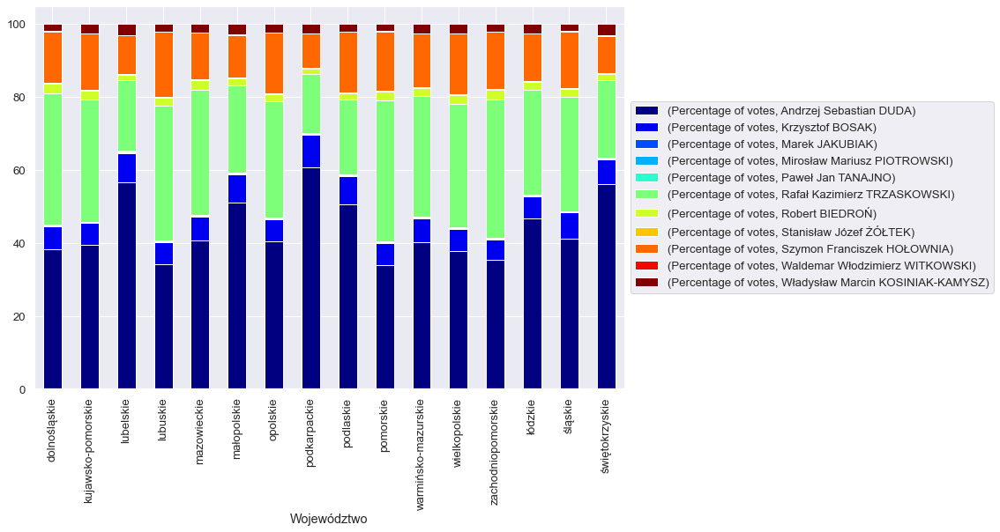

In [37]:
results_of_voting_for_candidates_in_the_FIRST_round_of_elections_percentage_by_voivodship_unstacked.plot(kind='bar', stacked=True, colormap='jet', figsize=(12,8)).legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.title("Frequency of genres by year 2000 - 2013. So far for data after 2013 is undersampled")
#plt.show()

# Candidates of SECOND round

In [38]:
candidates_of_second_round = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/kandydaci_csv.zip")
candidates_of_second_round.head(3)

,Pozycja na karcie,Nazwisko,Imiona,Płeć,Wiek,Wykształcenie,Zawód,Miejsce pracy,Miejsce zamieszkania,Przynależność do partii,Nazwa komitetu,Sygnatura,TERYT m. z.,Gmina m.z.,Liczba głosów,Procent wszystkich głosów,Wybrany
0,1,DUDA,Andrzej Sebastian,Mężczyzna,48,wyższe prawnicze,Prezydent Rzeczypospolitej Polskiej,NaN,Kraków,nie należy do partii politycznej,KOMITET WYBORCZY KANDYDATA NA PREZYDENTA RZECZ...,ZPOW-6020-5/20,126101,m. Kraków,10440648,"51,03",Tak
1,2,TRZASKOWSKI,Rafał Kazimierz,Mężczyzna,48,wyższe politologiczne,pracownik samorządowy,Urząd m.st. Warszawy,Warszawa,członek partii politycznej: Platforma Obywatel...,KOMITET WYBORCZY KANDYDATA NA PREZYDENTA RZECZ...,ZPOW-6020-41/20,146501,Warszawa,10018263,"48,97",Nie


In [39]:
candidates_of_second_round['Procent wszystkich głosów'] = candidates_of_second_round['Procent wszystkich głosów'].apply(lambda x: x.replace(',','.'))
candidates_of_second_round['Procent wszystkich głosów'] = pd.to_numeric(candidates_of_second_round['Procent wszystkich głosów'],errors='coerce')

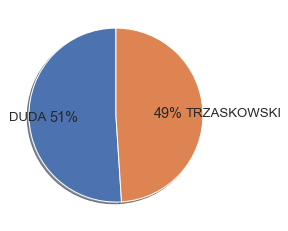

In [40]:
labels = candidates_of_second_round["Nazwisko"]
sizes = candidates_of_second_round["Procent wszystkich głosów"]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, autopct='%1.f%%', shadow=True, startangle=90, labeldistance=0.8)

plt.show()

# Voting wards in the SECOND round of elections

In [41]:
voting_wards_after_the_second_round_of_elections = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/obwody_glosowania_csv.zip")
voting_wards_after_the_second_round_of_elections.head(3)

,Nr OKW,TERYT gminy,Gmina,Powiat,Numer,Mieszkańcy,Wyborcy,Siedziba,Miejscowość,Ulica,Numer posesji,Numer lokalu,Kod pocztowy,Poczta,Typ obwodu,Przystosowany dla niepełnosprawnych,Typ obszaru,Pełna siedziba,Opis granic
0,5,46101,m. Bydgoszcz,Bydgoszcz,149,1865,1528,Szkoła Podstawowa nr 60,Bydgoszcz,ul. Bohaterów Kragujewca,10,NaN,85-863,Bydgoszcz,stały,Nie,miasto,"Szkoła Podstawowa nr 60, ul. Bohaterów Kraguje...","ulice: Chabrowa, Kąkolowa parzyste od nr 6 i n..."
1,36,221502,m. Rumia,wejherowski,4,2297,1803,Szkoła Podstawowa Nr 4,Rumia,ul. Świętojańska,11,NaN,84-230,Rumia,stały,Tak,miasto,"Szkoła Podstawowa Nr 4, ul. Świętojańska 11, 8...","3 Maja, Bydgoska, Elbląska, Grudziądzka, Harcm..."
2,8,61102,m. Stoczek Łukowski,łukowski,2,1043,797,Zespół Oświatowy w Stoczku Łukowskim,Stoczek Łukowski,Plac Wielgoska Stanisława,5,NaN,21-450,Stoczek Łukowski,stały,Tak,miasto,"Zespół Oświatowy w Stoczku Łukowskim, Plac Wie...","ulice: Adama Mickiewicza, Aleksandra Świętocho..."


# Composition of precinct election commissions in the SECOND round of elections

In [42]:
composition_of_precinct_election_commissions_in_the_first_round_of_elections = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/sklad_komisji_obwodowych_csv.zip")
composition_of_precinct_election_commissions_in_the_first_round_of_elections.head(3)

,TERYT gminy,Nazwa gminy,Powiat,Nr obw.,Nazwisko,Imiona,Funkcja
0,20101,m. Bolesławiec,bolesławiecki,1,Glinicka-Grabowy,Marta Anna,Przewodniczący
1,20101,m. Bolesławiec,bolesławiecki,1,Kowalczyk,Alicja Rozalia,Zastępca Przewodniczącego
2,20101,m. Bolesławiec,bolesławiecki,1,Czerepak,Daria,Członek


# Results of voting for candidates in the SECOND round of elections - by precincts

In [43]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_by_precincts = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/wyniki_gl_na_kand_po_obwodach_csv.zip")
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_by_precincts.head(3)

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3249: DtypeWarning: Columns (11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34) have mixed types. Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


,Symbol kontrolny,Nr OKW,Kod TERYT,Typ gminy,Numer obwodu,Typ obszaru,Typ obwodu,Siedziba,Gmina,Powiat,Województwo,Komisje obwodowe otrzymały kart do głosowania,Liczba wyborców uprawnionych do głosowania,Nie wykorzystano kart do głosowania,"Liczba wyborców, którym wydano karty do głosowania",Liczba wyborców głosujących przez pełnomocnika,Liczba wyborców głosujących na podstawie zaświadczenia o prawie do głosowania,"Liczba wyborców, którym wysłano pakiety wyborcze",Liczba otrzymanych kopert zwrotnych,"Liczba kopert zwrotnych, w których nie było oświadczenia o osobistym i tajnym oddaniu głosu","Liczba kopert zwrotnych, w których oświadczenie nie było podpisane","Liczba kopert zwrotnych, w których nie było koperty na kartę do głosowania","Liczba kopert zwrotnych, w których znajdowała się niezaklejona koperta na kartę do głosowania",Liczba kopert na kartę do głosowania wrzuconych do urny,Liczba kart wyjętych z urny,W tym liczba kart wyjętych z kopert na kartę do głosowania,Liczba kart nieważnych,Liczba kart ważnych,Liczba głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,Liczba głosów ważnych oddanych łącznie na wszystkich kandydatów,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI
0,895d-f6e1-b110-eb28-305f-41ed-f198-feb7,2.0,20101.0,gmina miejska,1,miasto,stały,"Szkoła Podstawowa Nr 3, ul. Ceramiczna 5, 59-7...",m. Bolesławiec,bolesławiecki,dolnośląskie,1442,1522,453,989,0,10,7,7,0,0,0,0,7,996,7,0,996,4,2,2,NaN,992,480,512
1,a845-41c5-25ab-69cc-db28-e14c-0094-f682,2.0,20101.0,gmina miejska,2,miasto,stały,"Szkoła Podstawowa Nr 3, ul. Ceramiczna 5, 59-7...",m. Bolesławiec,bolesławiecki,dolnośląskie,1230,1314,341,889,0,19,13,13,0,0,0,0,13,902,13,0,902,4,3,1,NaN,898,362,536
2,e9c7-5837-846b-c2e2-c2df-3f68-6ac8-497f,2.0,20101.0,gmina miejska,3,miasto,stały,"Szkoła Podstawowa Nr 5, ul. Dolne Młyny 60, 59...",m. Bolesławiec,bolesławiecki,dolnośląskie,1307,1399,370,937,0,9,8,8,0,0,0,0,8,945,8,0,945,11,9,2,NaN,934,401,533


# Results of voting for candidates in the SECOND round of elections - percentage by precincts

In [44]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_precincts = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/wyniki_gl_na_kand_po_obwodach_proc_csv.zip")
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_precincts.head(3)

,Symbol kontrolny,Nr OKW,Kod TERYT,Typ gminy,Numer obwodu,Typ obszaru,Typ obwodu,Siedziba,Gmina,Powiat,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI
0,895d-f6e1-b110-eb28-305f-41ed-f198-feb7,2.0,20101.0,gmina miejska,1,miasto,stały,"Szkoła Podstawowa Nr 3, ul. Ceramiczna 5, 59-7...",m. Bolesławiec,bolesławiecki,dolnośląskie,"65,44","0,40","50,00","50,00",NaN,"99,60","48,39","51,61"
1,a845-41c5-25ab-69cc-db28-e14c-0094-f682,2.0,20101.0,gmina miejska,2,miasto,stały,"Szkoła Podstawowa Nr 3, ul. Ceramiczna 5, 59-7...",m. Bolesławiec,bolesławiecki,dolnośląskie,"68,65","0,44","75,00","25,00",NaN,"99,56","40,31","59,69"
2,e9c7-5837-846b-c2e2-c2df-3f68-6ac8-497f,2.0,20101.0,gmina miejska,3,miasto,stały,"Szkoła Podstawowa Nr 5, ul. Dolne Młyny 60, 59...",m. Bolesławiec,bolesławiecki,dolnośląskie,"67,55","1,16","81,82","18,18",NaN,"98,84","42,93","57,07"


# Results of voting for candidates in the SECOND round of elections - by communes

In [45]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_by_communes = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/wyniki_gl_na_kand_po_gminach_csv.zip")
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_by_communes.head(3)

,Nr OKW,Kod TERYT,Rodzaj jednostki,Gmina,Powiat,Województwo,Komisje obwodowe otrzymały kart do głosowania,Liczba wyborców uprawnionych do głosowania,Nie wykorzystano kart do głosowania,"Liczba wyborców, którym wydano karty do głosowania",Liczba wyborców głosujących przez pełnomocnika,Liczba wyborców głosujących na podstawie zaświadczenia o prawie do głosowania,"Liczba wyborców, którym wysłano pakiety wyborcze",Liczba otrzymanych kopert zwrotnych,"Liczba kopert zwrotnych, w których nie było oświadczenia o osobistym i tajnym oddaniu głosu","Liczba kopert zwrotnych, w których oświadczenie nie było podpisane","Liczba kopert zwrotnych, w których nie było koperty na kartę do głosowania","Liczba kopert zwrotnych, w których znajdowała się niezaklejona koperta na kartę do głosowania",Liczba kopert na kartę do głosowania wrzuconych do urny,Liczba kart wyjętych z urny,W tym liczba kart wyjętych z kopert na kartę do głosowania,Liczba kart nieważnych,Liczba kart ważnych,Liczba głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,Liczba głosów ważnych oddanych łącznie na wszystkich kandydatów,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Liczba obwodów
0,2,20101,gmina miejska,m. Bolesławiec,bolesławiecki,dolnośląskie,27753,29061,8826,18929,3,309,212,207,5,0,0,0,202,19130,202,1,19129,145,85,60,NaN,18984,7915,11069,23
1,2,20102,gmina wiejska,gm. Bolesławiec,bolesławiecki,dolnośląskie,10455,11100,3273,7182,4,79,16,16,0,0,0,0,16,7198,16,0,7198,58,32,26,NaN,7140,3607,3533,11
2,2,20103,gmina wiejska,gm. Gromadka,bolesławiecki,dolnośląskie,3964,4277,1380,2584,4,23,11,9,0,0,0,0,10,2592,9,0,2592,20,8,12,NaN,2572,1617,955,4


# Results of voting for candidates in the SECOND round of elections - percentage by communes

In [46]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/wyniki_gl_na_kand_po_gminach_proc_csv.zip")
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes.head(3)

,Nr OKW,Kod TERYT,Rodzaj jednostki,Gmina,Powiat,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Liczba obwodów
0,2,20101,gmina miejska,m. Bolesławiec,bolesławiecki,dolnośląskie,"65,82","0,76","58,62","41,38",NaN,"99,24","41,69","58,31",23
1,2,20102,gmina wiejska,gm. Bolesławiec,bolesławiecki,dolnośląskie,"64,85","0,81","55,17","44,83",NaN,"99,19","50,52","49,48",11
2,2,20103,gmina wiejska,gm. Gromadka,bolesławiecki,dolnośląskie,"60,60","0,77","40,00","60,00",NaN,"99,23","62,87","37,13",4


# Results of voting for candidates in the SECOND round of elections - by poviats

In [47]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_by_poviats = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/wyniki_gl_na_kand_po_powiatach_csv.zip")
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_by_poviats.head(3)

,Nr OKW,Kod TERYT,Powiat,Województwo,Komisje obwodowe otrzymały kart do głosowania,Liczba wyborców uprawnionych do głosowania,Nie wykorzystano kart do głosowania,"Liczba wyborców, którym wydano karty do głosowania",Liczba wyborców głosujących przez pełnomocnika,Liczba wyborców głosujących na podstawie zaświadczenia o prawie do głosowania,"Liczba wyborców, którym wysłano pakiety wyborcze",Liczba otrzymanych kopert zwrotnych,"Liczba kopert zwrotnych, w których nie było oświadczenia o osobistym i tajnym oddaniu głosu","Liczba kopert zwrotnych, w których oświadczenie nie było podpisane","Liczba kopert zwrotnych, w których nie było koperty na kartę do głosowania","Liczba kopert zwrotnych, w których znajdowała się niezaklejona koperta na kartę do głosowania",Liczba kopert na kartę do głosowania wrzuconych do urny,Liczba kart wyjętych z urny,W tym liczba kart wyjętych z kopert na kartę do głosowania,Liczba kart nieważnych,Liczba kart ważnych,Liczba głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,Liczba głosów ważnych oddanych łącznie na wszystkich kandydatów,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Liczba obwodów
0,2,20100,bolesławiecki,dolnośląskie,63867,67800,21631,42238,13,633,356,342,6,0,1,1,335,42570,334,1,42569,322,179,143,NaN,42247,20966,21281,63
1,4,20200,dzierżoniowski,dolnośląskie,73104,77836,24749,48353,54,878,441,423,9,1,3,2,408,48759,408,4,48755,413,235,178,NaN,48342,24383,23959,83
2,3,20300,głogowski,dolnośląskie,63362,66323,19393,43970,20,719,309,298,12,2,0,0,284,44251,284,9,44242,363,231,132,NaN,43879,22722,21157,53


# Results of voting for candidates in the SECOND round of elections - in percentage by poviats

In [48]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_poviats = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/wyniki_gl_na_kand_po_powiatach_proc_csv.zip")
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_poviats.head(3)

,Nr OKW,Kod TERYT,Powiat,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Liczba obwodów
0,2,20100,bolesławiecki,dolnośląskie,"62,79","0,76","55,59","44,41",NaN,"99,24","49,63","50,37",63
1,4,20200,dzierżoniowski,dolnośląskie,"62,64","0,85","56,90","43,10",NaN,"99,15","50,44","49,56",83
2,3,20300,głogowski,dolnośląskie,"66,71","0,82","63,64","36,36",NaN,"99,18","51,78","48,22",53


# Results of voting for candidates in the SECOND round of elections - by voivodship

In [49]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_by_voivoidship = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/wyniki_gl_na_kand_po_wojewodztwach_csv.zip")
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_by_voivoidship.head(3)

,Kod TERYT,Województwo,Komisje obwodowe otrzymały kart do głosowania,Liczba wyborców uprawnionych do głosowania,Nie wykorzystano kart do głosowania,"Liczba wyborców, którym wydano karty do głosowania",Liczba wyborców głosujących przez pełnomocnika,Liczba wyborców głosujących na podstawie zaświadczenia o prawie do głosowania,"Liczba wyborców, którym wysłano pakiety wyborcze",Liczba otrzymanych kopert zwrotnych,"Liczba kopert zwrotnych, w których nie było oświadczenia o osobistym i tajnym oddaniu głosu","Liczba kopert zwrotnych, w których oświadczenie nie było podpisane","Liczba kopert zwrotnych, w których nie było koperty na kartę do głosowania","Liczba kopert zwrotnych, w których znajdowała się niezaklejona koperta na kartę do głosowania",Liczba kopert na kartę do głosowania wrzuconych do urny,Liczba kart wyjętych z urny,W tym liczba kart wyjętych z kopert na kartę do głosowania,Liczba kart nieważnych,Liczba kart ważnych,Liczba głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,Liczba głosów ważnych oddanych łącznie na wszystkich kandydatów,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Liczba obwodów
0,20000,dolnośląskie,2065241,2240376,578311,1487041,1334,41527,15246,14478,272,24,76,33,14093,1501048,14091,155,1500893,12953,7494,5459,NaN,1487940,663831,824109,1947
1,40000,kujawsko-pomorskie,1466205,1572933,446875,1019344,1001,21694,8605,8325,184,12,37,6,8088,1027376,8088,34,1027342,8142,4813,3329,NaN,1019200,476728,542472,1653
2,60000,lubelskie,1553552,1671659,460483,1093077,2237,22592,12004,11616,249,12,53,15,11291,1104299,11288,52,1104247,10164,5720,4444,NaN,1094083,725453,368630,1906


# Results of voting for candidates in the SECOND round of elections - by voivodship as a percentage

In [50]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_voivoidship = get_in_memory_data(url="https://wybory.gov.pl/prezydent20200628/data/2/csv/wyniki_gl_na_kand_po_wojewodztwach_proc_csv.zip")
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_voivoidship.head(3)

,Kod TERYT,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Liczba obwodów
0,20000,dolnośląskie,"66,99","0,86","57,86","42,14",NaN,"99,14","44,61","55,39",1947
1,40000,kujawsko-pomorskie,"65,31","0,79","59,11","40,89",NaN,"99,21","46,77","53,23",1653
2,60000,lubelskie,"66,06","0,92","56,28","43,72",NaN,"99,08","66,31","33,69",1906


# Maps - examples by voivoidship and communes

In [51]:
get_current_working_directory()


Current Working Directory Set As: C:\Users\KonuTech\Downloads\election



'C:\\Users\\KonuTech\\Downloads\\election'

In [52]:
get_list_of_files_from_directory(get_current_working_directory())


Current Working Directory Set As: C:\Users\KonuTech\Downloads\election


List Of Files: ['dudas_advantege_over_trzaskowski.html', 'dudas_support_by_communes.html', 'election_functions.ipynb', 'jednostki_administracyjne', 'jednostki_administracyjne.zip', 'LUDN_2137_XTAB_20200916001852.xlsx', 'RYNE_1944_XTAB_20200916002137.xlsx', 'trzaskowskis_support_by_communes.html', 'unemployment_rate.html', 'Wskazniki_dostepnosci_terytorialnej.xlsx']
From Directory: C:\Users\KonuTech\Downloads\election



['dudas_advantege_over_trzaskowski.html',
 'dudas_support_by_communes.html',
 'election_functions.ipynb',
 'jednostki_administracyjne',
 'jednostki_administracyjne.zip',
 'LUDN_2137_XTAB_20200916001852.xlsx',
 'RYNE_1944_XTAB_20200916002137.xlsx',
 'trzaskowskis_support_by_communes.html',
 'unemployment_rate.html',
 'Wskazniki_dostepnosci_terytorialnej.xlsx']

In [53]:
gus_population = 'LUDN_2137_XTAB_20200916001852.xlsx'
gus_unemployment = 'RYNE_1944_XTAB_20200916002137.xlsx'

In [54]:
population = pd.read_excel(gus_population, sheet_name="TABLICA")
population.dropna(inplace=True)
population["Kod"]=population["Kod"].astype(int)
population["population"]=population["ogółem"].astype(int)
population = population[['Kod','population']]
population.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4168 entries, 3 to 4170
Data columns (total 2 columns):
Kod           4168 non-null int32
population    4168 non-null int32
dtypes: int32(2)
memory usage: 65.1 KB


In [55]:
unemployment = pd.read_excel(gus_unemployment, sheet_name="TABLICA")
unemployment.dropna(inplace=True)
unemployment["Kod"]=unemployment["Kod"].astype(int)
unemployment["unemployment"]=unemployment["ogółem"].astype(int)
unemployment = unemployment[['Kod','unemployment']]
unemployment.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4150 entries, 2 to 4151
Data columns (total 2 columns):
Kod             4150 non-null int32
unemployment    4150 non-null int32
dtypes: int32(2)
memory usage: 64.8 KB


In [56]:
gus_data = pd.merge(population, unemployment, how='inner', on='Kod')
gus_data

,Kod,population,unemployment
0,0,38382576,866374
1,200000,2900163,56022
2,201000,90103,1293
3,201011,38872,516
4,201022,14699,198
...,...,...,...
4145,3261011,107048,2202
4146,3262000,401907,4274
4147,3262011,401907,4274
4148,3263000,40888,495


In [57]:
gus_data['unemployment_rate'] = 100 * gus_data['unemployment'] / gus_data['population']
gus_data

,Kod,population,unemployment,unemployment_rate
0,0,38382576,866374,2.257206
1,200000,2900163,56022,1.931685
2,201000,90103,1293,1.435024
3,201011,38872,516,1.327434
4,201022,14699,198,1.347030
...,...,...,...,...
4145,3261011,107048,2202,2.057021
4146,3262000,401907,4274,1.063430
4147,3262011,401907,4274,1.063430
4148,3263000,40888,495,1.210624


In [58]:
get_current_working_directory()


Current Working Directory Set As: C:\Users\KonuTech\Downloads\election



'C:\\Users\\KonuTech\\Downloads\\election'

In [59]:
gus_data["Kod_commune"] = gus_data["Kod"].apply(lambda x: '0'+str(x) if len(str(x)) < 7 else str(x))
gus_data.head()

,Kod,population,unemployment,unemployment_rate,Kod_commune
0,0,38382576,866374,2.257206,00
1,200000,2900163,56022,1.931685,0200000
2,201000,90103,1293,1.435024,0201000
3,201011,38872,516,1.327434,0201011
4,201022,14699,198,1.347030,0201022


In [60]:
gus_data['Kod_voivoidship'] = gus_data["Kod_commune"].apply(lambda s: s[:2])
gus_data.head()

,Kod,population,unemployment,unemployment_rate,Kod_commune,Kod_voivoidship
0,0,38382576,866374,2.257206,00,00
1,200000,2900163,56022,1.931685,0200000,02
2,201000,90103,1293,1.435024,0201000,02
3,201011,38872,516,1.327434,0201011,02
4,201022,14699,198,1.347030,0201022,02


In [61]:
gus_data = gus_data[gus_data['Kod'] != '0']

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\ops\__init__.py:1115: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  result = method(y)


In [62]:
# Voivoideships
gus_data_voivoidships = gus_data[gus_data["Kod_commune"].str[2:7] == '00000']
gus_data_voivoidships

,Kod,population,unemployment,unemployment_rate,Kod_commune,Kod_voivoidship
1,200000,2900163,56022,1.931685,0200000,02
313,400000,2072373,64060,3.091142,0400000,04
551,600000,2108270,69379,3.290802,0600000,06
845,800000,1011592,18498,1.828603,0800000,08
1010,1000000,2454779,58722,2.392150,1000000,10
1264,1200000,3410901,62610,1.835585,1200000,12
1565,1400000,5423168,123208,2.271882,1400000,14
2028,1600000,982626,20948,2.131839,1600000,16
2178,1800000,2127164,75455,3.547211,1800000,18
2434,2000000,1178353,33277,2.824026,2000000,20


In [63]:
# Communes
gus_data_communes = gus_data[gus_data["Kod_commune"].str[4:7] != '000']
gus_data_communes

,Kod,population,unemployment,unemployment_rate,Kod_commune,Kod_voivoidship
0,0,38382576,866374,2.257206,00,00
3,201011,38872,516,1.327434,0201011,02
4,201022,14699,198,1.347030,0201022,02
5,201032,5337,76,1.424021,0201032,02
6,201043,15214,234,1.538057,0201043,02
...,...,...,...,...,...,...
4142,3218054,2779,90,3.238575,3218054,32
4143,3218055,4111,262,6.373145,3218055,32
4145,3261011,107048,2202,2.057021,3261011,32
4147,3262011,401907,4274,1.063430,3262011,32


In [64]:
voivoidships_map = gpd.read_file('C:\\Users\\KonuTech\\Downloads\\election\\jednostki_administracyjne\\Województwa.shp')
#voivoidships_map.dtypes

In [65]:
communes_map = gpd.read_file('C:\\Users\\KonuTech\\Downloads\\election\\jednostki_administracyjne\\gminy.shp')
#communes_map.dtypes

In [66]:
voivoidships_map = voivoidships_map[['JPT_KOD_JE', "geometry"]]
voivoidships_map.head()

,JPT_KOD_JE,geometry
0,24,"MULTIPOLYGON (((18.91685 51.09608, 18.91677 51..."
1,16,"POLYGON ((17.81203 51.18669, 17.81209 51.18670..."
2,30,"POLYGON ((16.71447 53.29913, 16.71447 53.29920..."
3,26,"POLYGON ((19.70430 50.75239, 19.70443 50.75248..."
4,22,"POLYGON ((17.66483 54.78297, 17.66653 54.78334..."


In [67]:
communes_map = communes_map[['JPT_KOD_JE', "geometry"]]
communes_map.head()

,JPT_KOD_JE,geometry
0,1211023,"POLYGON ((20.46204 49.44509, 20.46203 49.44510..."
1,1205092,"POLYGON ((21.18392 49.63637, 21.18419 49.63677..."
2,0208143,"POLYGON ((16.40552 50.40402, 16.40503 50.40421..."
3,0208092,"POLYGON ((16.31290 50.44794, 16.31299 50.44799..."
4,0612023,"POLYGON ((21.91771 50.94934, 21.91763 50.94937..."


In [68]:
voivoidships_map_data = pd.merge(voivoidships_map, gus_data_voivoidships, how='left', left_on='JPT_KOD_JE', right_on='Kod_voivoidship')
voivoidships_map_data

,JPT_KOD_JE,geometry,Kod,population,unemployment,unemployment_rate,Kod_commune,Kod_voivoidship
0,24,"MULTIPOLYGON (((18.91685 51.09608, 18.91677 51...",2400000,4517635,66521,1.472474,2400000,24
1,16,"POLYGON ((17.81203 51.18669, 17.81209 51.18670...",1600000,982626,20948,2.131839,1600000,16
2,30,"POLYGON ((16.71447 53.29913, 16.71447 53.29920...",3000000,3498733,46313,1.323708,3000000,30
3,26,"POLYGON ((19.70430 50.75239, 19.70443 50.75248...",2600000,1233961,42042,3.407077,2600000,26
4,22,"POLYGON ((17.66483 54.78297, 17.66653 54.78334...",2200000,2343928,41817,1.784057,2200000,22
5,04,"POLYGON ((17.65670 53.57115, 17.65672 53.57115...",400000,2072373,64060,3.091142,0400000,04
6,20,"POLYGON ((21.98108 52.97859, 21.98078 52.97861...",2000000,1178353,33277,2.824026,2000000,20
7,32,"POLYGON ((14.81157 54.04037, 14.89525 54.05570...",3200000,1696193,41771,2.462632,3200000,32
8,02,"POLYGON ((15.10534 51.42730, 15.10540 51.42732...",200000,2900163,56022,1.931685,0200000,02
9,18,"POLYGON ((22.03538 50.80675, 22.03550 50.80681...",1800000,2127164,75455,3.547211,1800000,18


In [69]:
communes_map_data = pd.merge(communes_map, gus_data_communes, how='left', left_on='JPT_KOD_JE', right_on='Kod_commune')
communes_map_data

,JPT_KOD_JE,geometry,Kod,population,unemployment,unemployment_rate,Kod_commune,Kod_voivoidship
0,1211023,"POLYGON ((20.46204 49.44509, 20.46203 49.44510...",1211023.0,7204.0,270.0,3.747918,1211023,12
1,1205092,"POLYGON ((21.18392 49.63637, 21.18419 49.63677...",1205092.0,4980.0,105.0,2.108434,1205092,12
2,0208143,"POLYGON ((16.40552 50.40402, 16.40503 50.40421...",208143.0,7279.0,239.0,3.283418,0208143,02
3,0208092,"POLYGON ((16.31290 50.44794, 16.31299 50.44799...",208092.0,1923.0,64.0,3.328133,0208092,02
4,0612023,"POLYGON ((21.91771 50.94934, 21.91763 50.94937...",612023.0,6515.0,243.0,3.729854,0612023,06
...,...,...,...,...,...,...,...,...
2472,0216032,"POLYGON ((16.24351 51.52204, 16.24330 51.52213...",216032.0,5402.0,152.0,2.813773,0216032,02
2473,0216022,"POLYGON ((15.83150 51.57274, 15.82826 51.57274...",216022.0,3991.0,82.0,2.054623,0216022,02
2474,0404022,"MULTIPOLYGON (((18.46312 53.34684, 18.46312 53...",404022.0,6092.0,215.0,3.529219,0404022,04
2475,2402072,"POLYGON ((19.12591 49.79037, 19.12527 49.79041...",2402072.0,13024.0,98.0,0.752457,2402072,24


In [70]:
communes_map_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2477 entries, 0 to 2476
Data columns (total 8 columns):
JPT_KOD_JE           2477 non-null object
geometry             2477 non-null geometry
Kod                  2473 non-null float64
population           2473 non-null float64
unemployment         2473 non-null float64
unemployment_rate    2473 non-null float64
Kod_commune          2473 non-null object
Kod_voivoidship      2473 non-null object
dtypes: float64(4), geometry(1), object(3)
memory usage: 174.2+ KB


# Duda's support by communes

In [73]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes.head(3)

,Nr OKW,Kod TERYT,Rodzaj jednostki,Gmina,Powiat,Województwo,Frekwencja,% głosów nieważnych,W tym z powodu postawienia znaku „X” obok nazwiska dwóch lub większej liczby kandydatów,W tym z powodu niepostawienia znaku „X” obok nazwiska żadnego kandydata,W tym z powodu postawienia znaku „X” wyłącznie obok skreślonego nazwiska kandydata,% głosów ważnych,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Liczba obwodów
0,2,20101,gmina miejska,m. Bolesławiec,bolesławiecki,dolnośląskie,"65,82","0,76","58,62","41,38",NaN,"99,24","41,69","58,31",23
1,2,20102,gmina wiejska,gm. Bolesławiec,bolesławiecki,dolnośląskie,"64,85","0,81","55,17","44,83",NaN,"99,19","50,52","49,48",11
2,2,20103,gmina wiejska,gm. Gromadka,bolesławiecki,dolnośląskie,"60,60","0,77","40,00","60,00",NaN,"99,23","62,87","37,13",4


In [74]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes["Kod TERYT"]=results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes["Kod TERYT"].astype(str)
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes['Andrzej Sebastian DUDA'] = results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes['Andrzej Sebastian DUDA'].apply(lambda x: x.replace(',','.'))
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes['Andrzej Sebastian DUDA'] = pd.to_numeric(results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes['Andrzej Sebastian DUDA'],errors='coerce')
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes['Rafał Kazimierz TRZASKOWSKI'] = results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes['Rafał Kazimierz TRZASKOWSKI'].apply(lambda x: x.replace(',','.'))
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes['Rafał Kazimierz TRZASKOWSKI'] = pd.to_numeric(results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes['Rafał Kazimierz TRZASKOWSKI'],errors='coerce')

In [75]:
results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2496 entries, 0 to 2495
Data columns (total 15 columns):
Nr OKW                                                                                     2496 non-null int64
Kod TERYT                                                                                  2496 non-null object
Rodzaj jednostki                                                                           2496 non-null object
Gmina                                                                                      2496 non-null object
Powiat                                                                                     2496 non-null object
Województwo                                                                                2496 non-null object
Frekwencja                                                                                 2496 non-null object
% głosów nieważnych                                                                        2496 non-null objec

In [76]:
pkw_data = results_of_voting_for_candidates_in_the_SECOND_round_of_elections_percentage_by_communes[["Kod TERYT", "Rodzaj jednostki", "Andrzej Sebastian DUDA", "Rafał Kazimierz TRZASKOWSKI"]]
pkw_data

,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI
0,20101,gmina miejska,41.69,58.31
1,20102,gmina wiejska,50.52,49.48
2,20103,gmina wiejska,62.87,37.13
3,20104,gmina miejsko-wiejska,60.91,39.09
4,20105,gmina wiejska,51.17,48.83
...,...,...,...,...
2491,321804,gmina miejsko-wiejska,48.30,51.70
2492,321805,gmina miejsko-wiejska,52.79,47.21
2493,326101,gmina miejska,35.25,64.75
2494,326201,gmina miejska,36.32,63.68


In [77]:
pkw_data["Rodzaj jednostki"].unique()

array(['gmina miejska', 'gmina wiejska', 'gmina miejsko-wiejska',
       'dzielnica w m.st. Warszawa', 'statki', 'zagranica'], dtype=object)

In [78]:
pkw_data.loc[pkw_data['Rodzaj jednostki'] == "gmina miejska", 'Rodzaj jednostki number'] = '1'
pkw_data.loc[pkw_data['Rodzaj jednostki'] == "gmina wiejska", 'Rodzaj jednostki number'] = '2'
pkw_data.loc[pkw_data['Rodzaj jednostki'] == "gmina miejsko-wiejska", 'Rodzaj jednostki number'] = '3'
pkw_data.loc[pkw_data['Rodzaj jednostki'] == "dzielnica w m.st. Warszawa", 'Rodzaj jednostki number'] = '8'
pkw_data.loc[pkw_data['Rodzaj jednostki'] == "statki", 'Rodzaj jednostki number'] = '9'
pkw_data.loc[pkw_data['Rodzaj jednostki'] == "zagranica", 'Rodzaj jednostki number'] = '9'
pkw_data['Kod TERYT'] = pkw_data['Kod TERYT'].str.cat(pkw_data['Rodzaj jednostki number'],sep="")
pkw_data

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

S

,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number
0,201011,gmina miejska,41.69,58.31,1
1,201022,gmina wiejska,50.52,49.48,2
2,201032,gmina wiejska,62.87,37.13,2
3,201043,gmina miejsko-wiejska,60.91,39.09,3
4,201052,gmina wiejska,51.17,48.83,2
...,...,...,...,...,...
2491,3218043,gmina miejsko-wiejska,48.30,51.70,3
2492,3218053,gmina miejsko-wiejska,52.79,47.21,3
2493,3261011,gmina miejska,35.25,64.75,1
2494,3262011,gmina miejska,36.32,63.68,1


In [79]:
# Gmina Bolesławiec, Dolnośląskie, Gmina miejska
pkw_data[pkw_data["Kod TERYT"] == "201011"]

,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number
0,201011,gmina miejska,41.69,58.31,1


In [80]:
pkw_data["Kod_commune"] = pkw_data["Kod TERYT"].apply(lambda x: '0'+str(x) if len(str(x)) < 7 else str(x))
pkw_data.head()

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number,Kod_commune
0,201011,gmina miejska,41.69,58.31,1,0201011
1,201022,gmina wiejska,50.52,49.48,2,0201022
2,201032,gmina wiejska,62.87,37.13,2,0201032
3,201043,gmina miejsko-wiejska,60.91,39.09,3,0201043
4,201052,gmina wiejska,51.17,48.83,2,0201052


In [81]:
# Communes
pkw_data_communes = pkw_data[pkw_data["Kod_commune"].str[4:7] != '000']
pkw_data_communes

,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number,Kod_commune
0,201011,gmina miejska,41.69,58.31,1,0201011
1,201022,gmina wiejska,50.52,49.48,2,0201022
2,201032,gmina wiejska,62.87,37.13,2,0201032
3,201043,gmina miejsko-wiejska,60.91,39.09,3,0201043
4,201052,gmina wiejska,51.17,48.83,2,0201052
...,...,...,...,...,...,...
2491,3218043,gmina miejsko-wiejska,48.30,51.70,3,3218043
2492,3218053,gmina miejsko-wiejska,52.79,47.21,3,3218053
2493,3261011,gmina miejska,35.25,64.75,1,3261011
2494,3262011,gmina miejska,36.32,63.68,1,3262011


In [82]:
# Gmina Bolesławiec, Dolnośląskie, Gmina miejska
# https://romek.info/ut/dolnoslaskie.html

In [83]:
communes_map[communes_map["JPT_KOD_JE"] == "0201011"]

,JPT_KOD_JE,geometry
592,0201011,"POLYGON ((15.56824 51.22638, 15.56818 51.22651..."


In [84]:
communes_map_data = pd.merge(communes_map, pkw_data_communes, how='left', left_on='JPT_KOD_JE', right_on='Kod_commune')
communes_map_data

,JPT_KOD_JE,geometry,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number,Kod_commune
0,1211023,"POLYGON ((20.46204 49.44509, 20.46203 49.44510...",1211023,gmina miejsko-wiejska,52.65,47.35,3,1211023
1,1205092,"POLYGON ((21.18392 49.63637, 21.18419 49.63677...",1205092,gmina wiejska,63.33,36.67,2,1205092
2,0208143,"POLYGON ((16.40552 50.40402, 16.40503 50.40421...",208143,gmina miejsko-wiejska,45.28,54.72,3,0208143
3,0208092,"POLYGON ((16.31290 50.44794, 16.31299 50.44799...",208092,gmina wiejska,45.71,54.29,2,0208092
4,0612023,"POLYGON ((21.91771 50.94934, 21.91763 50.94937...",612023,gmina miejsko-wiejska,76.59,23.41,3,0612023
...,...,...,...,...,...,...,...,...
2472,0216032,"POLYGON ((16.24351 51.52204, 16.24330 51.52213...",216032,gmina wiejska,65.01,34.99,2,0216032
2473,0216022,"POLYGON ((15.83150 51.57274, 15.82826 51.57274...",216022,gmina wiejska,65.53,34.47,2,0216022
2474,0404022,"MULTIPOLYGON (((18.46312 53.34684, 18.46312 53...",404022,gmina wiejska,51.65,48.35,2,0404022
2475,2402072,"POLYGON ((19.12591 49.79037, 19.12527 49.79041...",2402072,gmina wiejska,50.27,49.73,2,2402072


In [85]:
communes_map_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2477 entries, 0 to 2476
Data columns (total 8 columns):
JPT_KOD_JE                     2477 non-null object
geometry                       2477 non-null geometry
Kod TERYT                      2476 non-null object
Rodzaj jednostki               2476 non-null object
Andrzej Sebastian DUDA         2476 non-null float64
Rafał Kazimierz TRZASKOWSKI    2476 non-null float64
Rodzaj jednostki number        2476 non-null object
Kod_commune                    2476 non-null object
dtypes: float64(2), geometry(1), object(5)
memory usage: 174.2+ KB


In [86]:
communes_map_data["Andrzej Sebastian DUDA"].unique()

array([52.65, 63.33, 45.28, ..., 83.75, 65.01, 48.5 ])

In [87]:
communes_map_data['Dudas percentage of votes'] = communes_map_data['Andrzej Sebastian DUDA'] / 100
communes_map_data['Trzaskowskis percentage of votes'] = communes_map_data['Rafał Kazimierz TRZASKOWSKI'] / 100
communes_map_data['Difference in percentage points'] = communes_map_data['Trzaskowskis percentage of votes'] - communes_map_data['Dudas percentage of votes']
communes_map_data['Who won'] = communes_map_data['Dudas percentage of votes'].apply(lambda x: 1 if x > 0.5 else 0)
communes_map_data

,JPT_KOD_JE,geometry,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number,Kod_commune,Dudas percentage of votes,Trzaskowskis percentage of votes,Difference in percentage points,Who won
0,1211023,"POLYGON ((20.46204 49.44509, 20.46203 49.44510...",1211023,gmina miejsko-wiejska,52.65,47.35,3,1211023,0.5265,0.4735,-0.0530,1
1,1205092,"POLYGON ((21.18392 49.63637, 21.18419 49.63677...",1205092,gmina wiejska,63.33,36.67,2,1205092,0.6333,0.3667,-0.2666,1
2,0208143,"POLYGON ((16.40552 50.40402, 16.40503 50.40421...",208143,gmina miejsko-wiejska,45.28,54.72,3,0208143,0.4528,0.5472,0.0944,0
3,0208092,"POLYGON ((16.31290 50.44794, 16.31299 50.44799...",208092,gmina wiejska,45.71,54.29,2,0208092,0.4571,0.5429,0.0858,0
4,0612023,"POLYGON ((21.91771 50.94934, 21.91763 50.94937...",612023,gmina miejsko-wiejska,76.59,23.41,3,0612023,0.7659,0.2341,-0.5318,1
...,...,...,...,...,...,...,...,...,...,...,...,...
2472,0216032,"POLYGON ((16.24351 51.52204, 16.24330 51.52213...",216032,gmina wiejska,65.01,34.99,2,0216032,0.6501,0.3499,-0.3002,1
2473,0216022,"POLYGON ((15.83150 51.57274, 15.82826 51.57274...",216022,gmina wiejska,65.53,34.47,2,0216022,0.6553,0.3447,-0.3106,1
2474,0404022,"MULTIPOLYGON (((18.46312 53.34684, 18.46312 53...",404022,gmina wiejska,51.65,48.35,2,0404022,0.5165,0.4835,-0.0330,1
2475,2402072,"POLYGON ((19.12591 49.79037, 19.12527 49.79041...",2402072,gmina wiejska,50.27,49.73,2,2402072,0.5027,0.4973,-0.0054,1


# Duda's support by communes - Map

In [88]:
communes_map_data.geometry = communes_map_data.geometry.simplify(0.005) # mniejsza wartosc = bardziej dokładnie
communes_map_data_json = communes_map_data.to_json()
mapa = folium.Map([52, 19], zoom_start=7)
 
folium.Choropleth(geo_data=communes_map_data_json,
                  data=communes_map_data,
                  columns=['Kod_commune', 'Dudas percentage of votes'],
                  key_on='feature.properties.JPT_KOD_JE',
                  fill_color='YlOrRd', 
                  fill_opacity=1,
                  line_opacity=0.2,
                  legend_name="Dudas support by communes").add_to(mapa)

mapa.save(outfile = 'dudas_support_by_communes.html')

mapa

# Trzaskowski's support by communes - Map

In [89]:
communes_map_data.geometry = communes_map_data.geometry.simplify(0.005) # mniejsza wartosc = bardziej dokładnie
communes_map_data_json = communes_map_data.to_json()
mapa = folium.Map([52, 19], zoom_start=7)
 
folium.Choropleth(geo_data=communes_map_data_json,
                  data=communes_map_data,
                  columns=['Kod_commune', 'Trzaskowskis percentage of votes'],
                  key_on='feature.properties.JPT_KOD_JE',
                  fill_color='Blues', 
                  fill_opacity=1,
                  line_opacity=0.2,
                  legend_name="Trzaskowskis support by communes").add_to(mapa)

mapa.save(outfile = 'trzaskowskis_support_by_communes.html')

mapa

# Dudas advantege over Trzaskowski - Map

In [90]:
communes_map_data.geometry = communes_map_data.geometry.simplify(0.005) # mniejsza wartosc = bardziej dokładnie
communes_map_data_json = communes_map_data.to_json()
mapa = folium.Map([52, 19], zoom_start=7)
 
folium.Choropleth(geo_data=communes_map_data_json,
                  data=communes_map_data,
                  columns=['Kod_commune', 'Difference in percentage points'],
                  key_on='feature.properties.JPT_KOD_JE',
                  fill_color='RdBu', 
                  fill_opacity=1,
                  line_opacity=0.2,
                  legend_name="Dudas advantege over Trzaskowski").add_to(mapa)

mapa.save(outfile = 'dudas_advantege_over_trzaskowski.html')

mapa

# Who won at particular commune - Map

In [91]:
communes_map_data.geometry = communes_map_data.geometry.simplify(0.005) # mniejsza wartosc = bardziej dokładnie
communes_map_data_json = communes_map_data.to_json()
mapa = folium.Map([52, 19], zoom_start=7)
 
folium.Choropleth(geo_data=communes_map_data_json,
                  data=communes_map_data,
                  columns=['Kod_commune', 'Who won'],
                  key_on='feature.properties.JPT_KOD_JE',
                  fill_color='YlOrRd', 
                  fill_opacity=1,
                  line_opacity=0.2,
                  legend_name="Who won by communes - red: Duda").add_to(mapa)

mapa.save(outfile = 'dudas_advantege_over_trzaskowski.html')

mapa

# Wskaźnik dostępności terytotialnej do wybranych obiektów użyteczności publicznej

In [92]:
# https://stat.gov.pl/statystyki-eksperymentalne/obszary-funkcjonalne-oraz-dostepnosc-terytorialna/wskazniki-dostepnosci-terytorialnej-mieszkancow-polski-do-wybranych-obiektow-uzytecznosci-publicznej,2,1.html

In [93]:
get_current_working_directory()


Current Working Directory Set As: C:\Users\KonuTech\Downloads\election



'C:\\Users\\KonuTech\\Downloads\\election'

In [94]:
get_list_of_files_from_directory(get_current_working_directory())


Current Working Directory Set As: C:\Users\KonuTech\Downloads\election


List Of Files: ['dudas_advantege_over_trzaskowski.html', 'dudas_support_by_communes.html', 'election_functions.ipynb', 'jednostki_administracyjne', 'jednostki_administracyjne.zip', 'LUDN_2137_XTAB_20200916001852.xlsx', 'RYNE_1944_XTAB_20200916002137.xlsx', 'trzaskowskis_support_by_communes.html', 'unemployment_rate.html', 'Wskazniki_dostepnosci_terytorialnej.xlsx']
From Directory: C:\Users\KonuTech\Downloads\election



['dudas_advantege_over_trzaskowski.html',
 'dudas_support_by_communes.html',
 'election_functions.ipynb',
 'jednostki_administracyjne',
 'jednostki_administracyjne.zip',
 'LUDN_2137_XTAB_20200916001852.xlsx',
 'RYNE_1944_XTAB_20200916002137.xlsx',
 'trzaskowskis_support_by_communes.html',
 'unemployment_rate.html',
 'Wskazniki_dostepnosci_terytorialnej.xlsx']

In [95]:
indicators_of_territorial_accessibility = 'Wskazniki_dostepnosci_terytorialnej.xlsx'

In [96]:
territorial_accessibility_metadata = pd.read_excel(indicators_of_territorial_accessibility, sheet_name="METADANE")
territorial_accessibility_metadata

,TERYT,Kod terytorialny gminy / dzielnicy
0,WOJEW,Nazwa województwa
1,GMINA,Nazwa gminy
2,POWIAT,Nazwa powiatu
3,W1,Placówki wychowania przedszkolnego (bez oddzia...
4,W2,Placówki wychowania przedszkolnego
5,W3,Szkoły podstawowe dla dzieci
6,W4,Szkoły ponadgimnazjalne dla młodzieży (zasadni...
7,W5,Komendy/komisariaty/posterunki policji
8,W6,Straż pożarna
9,W7,Biblioteki publiczne (łącznie z filiami dla dz...


In [97]:
territorial_accessibility = pd.read_excel(indicators_of_territorial_accessibility, sheet_name="ODLEGLOSC")
territorial_accessibility["TERYT"] = territorial_accessibility.astype(str)
territorial_accessibility["Kod_commune"] = territorial_accessibility["TERYT"].apply(lambda x: '0' + str(x) if len(str(x)) < 7 else str(x))
territorial_accessibility.head(3)

,TERYT,WOJEW,GMINA,POWIAT,W1,W2,W3,W4,W5,W6,W7,W8,W9,W10,W11,W12,W13,W14,W15,W16,W17,W18,W19,W20,Kod_commune
0,201011,Dolnośląskie,Bolesławiec,bolesławiecki,699.8,772.7,715.6,757.7,929.7,1560.4,1213.5,1153.2,1349.5,751.4,718.0,62500.0,62500.0,2537.4,2549.3,2535.2,87499.4,1428.7,1318.8,2500.3,0201011
1,201022,Dolnośląskie,Bolesławiec,bolesławiecki,1786.8,1590.3,1754.7,6040.1,4318.5,5445.7,2528.1,2495.2,5951.4,3827.5,3761.6,66636.6,66451.2,7433.6,7399.4,7522.1,83919.3,7275.8,7475.9,7280.9,0201022
2,201032,Dolnośląskie,Gromadka,bolesławiecki,3814.2,2766.0,2785.0,12506.3,2472.7,2472.7,3631.5,3344.4,3473.5,3632.6,3367.3,54467.1,54879.5,15912.9,18838.8,18677.0,81957.2,3615.1,18930.5,18142.9,0201032


In [98]:
territorial_accessibility.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2495 entries, 0 to 2494
Data columns (total 25 columns):
TERYT          2495 non-null object
WOJEW          2495 non-null object
GMINA          2495 non-null object
POWIAT         2495 non-null object
W1             2495 non-null float64
W2             2495 non-null float64
W3             2495 non-null float64
W4             2495 non-null float64
W5             2495 non-null float64
W6             2495 non-null float64
W7             2495 non-null float64
W8             2495 non-null float64
W9             2495 non-null float64
W10            2495 non-null float64
W11            2495 non-null float64
W12            2495 non-null float64
W13            2495 non-null float64
W14            2495 non-null float64
W15            2495 non-null float64
W16            2495 non-null float64
W17            2495 non-null float64
W18            2495 non-null float64
W19            2495 non-null float64
W20            2495 non-null float64
Kod_commu

In [99]:
communes_map_data.head(3)

,JPT_KOD_JE,geometry,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number,Kod_commune,Dudas percentage of votes,Trzaskowskis percentage of votes,Difference in percentage points,Who won
0,1211023,"POLYGON ((20.46204 49.44509, 20.46999 49.46469...",1211023,gmina miejsko-wiejska,52.65,47.35,3,1211023,0.5265,0.4735,-0.0530,1
1,1205092,"POLYGON ((21.18392 49.63637, 21.18862 49.64160...",1205092,gmina wiejska,63.33,36.67,2,1205092,0.6333,0.3667,-0.2666,1
2,0208143,"POLYGON ((16.40552 50.40402, 16.37593 50.42153...",208143,gmina miejsko-wiejska,45.28,54.72,3,0208143,0.4528,0.5472,0.0944,0


In [100]:
communes_territorial_accessibility = pd.merge(communes_map_data, territorial_accessibility, how='left', left_on='JPT_KOD_JE', right_on='Kod_commune')
communes_territorial_accessibility

,JPT_KOD_JE,geometry,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number,Kod_commune_x,Dudas percentage of votes,Trzaskowskis percentage of votes,Difference in percentage points,Who won,TERYT,WOJEW,GMINA,POWIAT,W1,W2,W3,W4,W5,W6,W7,W8,W9,W10,W11,W12,W13,W14,W15,W16,W17,W18,W19,W20,Kod_commune_y
0,1211023,"POLYGON ((20.46204 49.44509, 20.46999 49.46469...",1211023,gmina miejsko-wiejska,52.65,47.35,3,1211023,0.5265,0.4735,-0.0530,1,1211023,Małopolskie,Szczawnica,nowotarski,2021.6,1174.2,1453.7,2263.6,1863.3,1863.8,2359.9,2178.4,1970.8,2035.1,1840.5,62500.0,62500.0,7144.2,34859.5,34869.5,93644.9,1869.6,33673.0,41709.9,1211023
1,1205092,"POLYGON ((21.18392 49.63637, 21.18862 49.64160...",1205092,gmina wiejska,63.33,36.67,2,1205092,0.6333,0.3667,-0.2666,1,1205092,Małopolskie,Sękowa,gorlicki,2881.7,2598.2,2642.0,9131.9,3954.6,3957.0,4896.0,4490.8,4247.1,3881.3,3686.9,150000.0,150000.0,8040.1,8873.2,8265.4,87524.7,4956.4,9862.8,10051.3,1205092
2,0208143,"POLYGON ((16.40552 50.40402, 16.37593 50.42153...",208143,gmina miejsko-wiejska,45.28,54.72,3,0208143,0.4528,0.5472,0.0944,0,208143,Dolnośląskie,Szczytna,kłodzki,1881.3,2351.4,1990.4,4944.2,2500.9,2544.5,2275.6,2157.8,4779.6,2156.1,1959.6,96531.8,95569.7,6934.3,5920.7,5529.2,95727.7,3025.7,17029.4,15844.0,0208143
3,0208092,"POLYGON ((16.31290 50.44794, 16.31288 50.45637...",208092,gmina wiejska,45.71,54.29,2,0208092,0.4571,0.5429,0.0858,0,208092,Dolnośląskie,Lewin Kłodzki,kłodzki,1970.6,1700.0,1826.9,5421.1,1766.2,1792.8,1775.2,1775.3,4739.0,1733.2,1698.6,150000.0,150000.0,6397.5,15485.1,15941.9,150000.0,1919.9,26445.5,26796.4,0208092
4,0612023,"POLYGON ((21.91771 50.94934, 21.91158 50.96911...",612023,gmina miejsko-wiejska,76.59,23.41,3,0612023,0.7659,0.2341,-0.5318,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2472,0216032,"POLYGON ((16.24351 51.52204, 16.21101 51.52434...",216032,gmina wiejska,65.01,34.99,2,0216032,0.6501,0.3499,-0.3002,1,216032,Dolnośląskie,Grębocice,polkowicki,4013.4,4116.7,2932.9,9724.1,3514.8,3514.8,3075.5,3080.2,3344.9,3990.5,4020.8,34823.7,34689.3,12581.2,14787.5,14633.4,64199.7,4380.8,15378.6,12912.8,0216032
2473,0216022,"POLYGON ((15.83150 51.57274, 15.82362 51.57274...",216022,gmina wiejska,65.53,34.47,2,0216022,0.6553,0.3447,-0.3106,1,216022,Dolnośląskie,Gaworzyce,polkowicki,2732.8,2424.5,2382.2,12102.8,2884.1,2884.1,1795.5,1844.5,2963.1,2392.5,2357.2,46122.9,46863.2,14071.3,14276.1,14051.9,46736.8,2834.8,21969.3,15000.0,0216022
2474,0404022,"MULTIPOLYGON (((18.46312 53.34684, 18.47296 53...",404022,gmina wiejska,51.65,48.35,2,0404022,0.5165,0.4835,-0.0330,1,404022,Kujawsko-pomorskie,Chełmno,chełmiński,7804.6,3041.2,2977.2,8216.7,3182.4,3184.5,2628.0,2626.2,8576.0,4314.7,4395.9,46966.4,47303.7,9873.3,14961.6,14958.6,47483.9,8822.4,9051.0,9402.3,0404022
2475,2402072,"POLYGON ((19.12591 49.79037, 19.11925 49.80016...",2402072,gmina wiejska,50.27,49.73,2,2402072,0.5027,0.4973,-0.0054,1,2402072,Śląskie,Kozy,bielski,1372.5,1286.1,1374.8,1626.3,1745.5,1745.5,1582.0,1538.5,1758.0,1710.9,1707.4,56212.2,56247.0,6787.8,14267.3,14120.1,62500.0,1752.0,10731.0,9846.2,2402072


In [101]:
communes_territorial_accessibility["W1_percent"] = communes_territorial_accessibility["W1"] / communes_territorial_accessibility["W1"].max()
communes_territorial_accessibility["W2_percent"] = communes_territorial_accessibility["W2"] / communes_territorial_accessibility["W2"].max()
communes_territorial_accessibility["W3_percent"] = communes_territorial_accessibility["W3"] / communes_territorial_accessibility["W3"].max()
communes_territorial_accessibility["W4_percent"] = communes_territorial_accessibility["W4"] / communes_territorial_accessibility["W4"].max()
communes_territorial_accessibility["W5_percent"] = communes_territorial_accessibility["W5"] / communes_territorial_accessibility["W5"].max()
communes_territorial_accessibility["W6_percent"] = communes_territorial_accessibility["W6"] / communes_territorial_accessibility["W6"].max()
communes_territorial_accessibility["W7_percent"] = communes_territorial_accessibility["W7"] / communes_territorial_accessibility["W7"].max()
communes_territorial_accessibility["W8_percent"] = communes_territorial_accessibility["W8"] / communes_territorial_accessibility["W8"].max()
communes_territorial_accessibility["W9_percent"] = communes_territorial_accessibility["W9"] / communes_territorial_accessibility["W9"].max()
communes_territorial_accessibility["W10_percent"] = communes_territorial_accessibility["W10"] / communes_territorial_accessibility["W10"].max()
communes_territorial_accessibility["W11_percent"] = communes_territorial_accessibility["W11"] / communes_territorial_accessibility["W11"].max()
communes_territorial_accessibility["W12_percent"] = communes_territorial_accessibility["W12"] / communes_territorial_accessibility["W12"].max()
communes_territorial_accessibility["W13_percent"] = communes_territorial_accessibility["W13"] / communes_territorial_accessibility["W13"].max()
communes_territorial_accessibility["W14_percent"] = communes_territorial_accessibility["W14"] / communes_territorial_accessibility["W14"].max()
communes_territorial_accessibility["W15_percent"] = communes_territorial_accessibility["W15"] / communes_territorial_accessibility["W15"].max()
communes_territorial_accessibility["W16_percent"] = communes_territorial_accessibility["W16"] / communes_territorial_accessibility["W16"].max()
communes_territorial_accessibility["W17_percent"] = communes_territorial_accessibility["W17"] / communes_territorial_accessibility["W17"].max()
communes_territorial_accessibility["W18_percent"] = communes_territorial_accessibility["W18"] / communes_territorial_accessibility["W18"].max()
communes_territorial_accessibility["W19_percent"] = communes_territorial_accessibility["W19"] / communes_territorial_accessibility["W19"].max()
communes_territorial_accessibility["W20_percent"] = communes_territorial_accessibility["W20"] / communes_territorial_accessibility["W20"].max()
communes_territorial_accessibility.head(3)

,JPT_KOD_JE,geometry,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number,Kod_commune_x,Dudas percentage of votes,Trzaskowskis percentage of votes,Difference in percentage points,Who won,TERYT,WOJEW,GMINA,POWIAT,W1,W2,W3,W4,W5,W6,W7,W8,W9,W10,W11,W12,W13,W14,W15,W16,W17,W18,W19,W20,Kod_commune_y,W1_percent,W2_percent,W3_percent,W4_percent,W5_percent,W6_percent,W7_percent,W8_percent,W9_percent,W10_percent,W11_percent,W12_percent,W13_percent,W14_percent,W15_percent,W16_percent,W17_percent,W18_percent,W19_percent,W20_percent
0,1211023,"POLYGON ((20.46204 49.44509, 20.46999 49.46469...",1211023,gmina miejsko-wiejska,52.65,47.35,3,1211023,0.5265,0.4735,-0.0530,1,1211023,Małopolskie,Szczawnica,nowotarski,2021.6,1174.2,1453.7,2263.6,1863.3,1863.8,2359.9,2178.4,1970.8,2035.1,1840.5,62500.0,62500.0,7144.2,34859.5,34869.5,93644.9,1869.6,33673.0,41709.9,1211023,0.129702,0.138411,0.206459,0.132847,0.107677,0.113076,0.253260,0.232076,0.120314,0.170113,0.152570,0.270710,0.255553,0.262610,0.636429,0.636237,0.441993,0.155797,1.000000,0.769531
1,1205092,"POLYGON ((21.18392 49.63637, 21.18862 49.64160...",1205092,gmina wiejska,63.33,36.67,2,1205092,0.6333,0.3667,-0.2666,1,1205092,Małopolskie,Sękowa,gorlicki,2881.7,2598.2,2642.0,9131.9,3954.6,3957.0,4896.0,4490.8,4247.1,3881.3,3686.9,150000.0,150000.0,8040.1,8873.2,8265.4,87524.7,4956.4,9862.8,10051.3,1205092,0.184884,0.306269,0.375225,0.535938,0.228530,0.240070,0.525429,0.478427,0.259278,0.324437,0.305629,0.649703,0.613327,0.295542,0.161998,0.150813,0.413106,0.413026,0.292899,0.185443
2,0208143,"POLYGON ((16.40552 50.40402, 16.37593 50.42153...",208143,gmina miejsko-wiejska,45.28,54.72,3,0208143,0.4528,0.5472,0.0944,0,208143,Dolnośląskie,Szczytna,kłodzki,1881.3,2351.4,1990.4,4944.2,2500.9,2544.5,2275.6,2157.8,4779.6,2156.1,1959.6,96531.8,95569.7,6934.3,5920.7,5529.2,95727.7,3025.7,17029.4,15844.0,0208143,0.120701,0.277177,0.282683,0.290168,0.144523,0.154374,0.244213,0.229881,0.291786,0.180228,0.162443,0.418113,0.390770,0.254894,0.108094,0.100887,0.451823,0.252137,0.505729,0.292316


In [102]:
communes_territorial_accessibility["Placówki wychowania przedszkolnego (bez oddzia..._percent of max"] = communes_territorial_accessibility["W1"] / communes_territorial_accessibility["W1"].max()
communes_territorial_accessibility["Placówki wychowania przedszkolnego_percent of max"] = communes_territorial_accessibility["W2"] / communes_territorial_accessibility["W2"].max()
communes_territorial_accessibility["Szkoły podstawowe dla dzieci_percent of max"] = communes_territorial_accessibility["W3"] / communes_territorial_accessibility["W3"].max()
communes_territorial_accessibility["Szkoły ponadgimnazjalne dla młodzieży (zasadni..._percent of max"] = communes_territorial_accessibility["W4"] / communes_territorial_accessibility["W4"].max()
communes_territorial_accessibility["Komendy/komisariaty/posterunki policji_percent of max"] = communes_territorial_accessibility["W5"] / communes_territorial_accessibility["W5"].max()
communes_territorial_accessibility["Straż pożarna_percent of max"] = communes_territorial_accessibility["W6"] / communes_territorial_accessibility["W6"].max()
communes_territorial_accessibility["Biblioteki publiczne (łącznie z filiami dla dz..._percent of max"] = communes_territorial_accessibility["W7"] / communes_territorial_accessibility["W7"].max()
communes_territorial_accessibility["Biblioteki publiczne (bez filii dla dzieci)_percent of max"] = communes_territorial_accessibility["W8"] / communes_territorial_accessibility["W8"].max()
communes_territorial_accessibility["Centra kultury, domy kultury, ośrodki kultury,..._percent of max"] = communes_territorial_accessibility["W9"] / communes_territorial_accessibility["W9"].max()
communes_territorial_accessibility["Przychodnie zdrowia świadczące usługi poz (łąc..._percent of max"] = communes_territorial_accessibility["W10"] / communes_territorial_accessibility["W10"].max()
communes_territorial_accessibility["Przychodnie zdrowia świadczące usługi poz (bez..._percent of max"] = communes_territorial_accessibility["W11"] / communes_territorial_accessibility["W11"].max()
communes_territorial_accessibility["Szpitale kliniczne (łącznie z dziecięcymi)_percent of max"] = communes_territorial_accessibility["W12"] / communes_territorial_accessibility["W12"].max()
communes_territorial_accessibility["Szpitale kliniczne (bez dziecięcych)_percent of max"] = communes_territorial_accessibility["W13"] / communes_territorial_accessibility["W13"].max()
communes_territorial_accessibility["Stacje pogotowia ratunkowego_percent of max"] = communes_territorial_accessibility["W14"] / communes_territorial_accessibility["W14"].max()
communes_territorial_accessibility["Szpitalne oddziały ratunkowe (łącznie z dzieci..._percent of max"] = communes_territorial_accessibility["W15"] / communes_territorial_accessibility["W15"].max()
communes_territorial_accessibility["Szpitalne oddziały ratunkowe (bez dziecięcych)_percent of max"] = communes_territorial_accessibility["W16"] / communes_territorial_accessibility["W16"].max()
communes_territorial_accessibility["Centra urazowe_percent of max"] = communes_territorial_accessibility["W17"] / communes_territorial_accessibility["W17"].max()
communes_territorial_accessibility["Urzędy gminne/miejskie/dzielnicowe (w ramach j..._percent of max"] = communes_territorial_accessibility["W18"] / communes_territorial_accessibility["W18"].max()
communes_territorial_accessibility["Starostwa powiatowe + urzędy miejskie w miasta..._percent of max"] = communes_territorial_accessibility["W19"] / communes_territorial_accessibility["W19"].max()
communes_territorial_accessibility["Sądy rejonowe (w ramach właściwości miejscowej)_percent of max"] = communes_territorial_accessibility["W20"] / communes_territorial_accessibility["W20"].max()

communes_territorial_accessibility.head(3)

,JPT_KOD_JE,geometry,Kod TERYT,Rodzaj jednostki,Andrzej Sebastian DUDA,Rafał Kazimierz TRZASKOWSKI,Rodzaj jednostki number,Kod_commune_x,Dudas percentage of votes,Trzaskowskis percentage of votes,Difference in percentage points,Who won,TERYT,WOJEW,GMINA,POWIAT,W1,W2,W3,W4,W5,W6,W7,W8,W9,W10,W11,W12,W13,W14,W15,W16,W17,W18,W19,W20,Kod_commune_y,W1_percent,W2_percent,W3_percent,W4_percent,W5_percent,W6_percent,W7_percent,W8_percent,W9_percent,W10_percent,W11_percent,W12_percent,W13_percent,W14_percent,W15_percent,W16_percent,W17_percent,W18_percent,W19_percent,W20_percent,Placówki wychowania przedszkolnego (bez oddzia..._percent of max,Placówki wychowania przedszkolnego_percent of max,Szkoły podstawowe dla dzieci_percent of max,Szkoły ponadgimnazjalne dla młodzieży (zasadni..._percent of max,Komendy/komisariaty/posterunki policji_percent of max,Straż pożarna_percent of max,Biblioteki publiczne (łącznie z filiami dla dz..._percent of max,Biblioteki publiczne (bez filii dla dzieci)_percent of max,"Centra kultury, domy kultury, ośrodki kultury,..._percent of max",Przychodnie zdrowia świadczące usługi poz (łąc..._percent of max,Przychodnie zdrowia świadczące usługi poz (bez..._percent of max,Szpitale kliniczne (łącznie z dziecięcymi)_percent of max,Szpitale kliniczne (bez dziecięcych)_percent of max,Stacje pogotowia ratunkowego_percent of max,Szpitalne oddziały ratunkowe (łącznie z dzieci..._percent of max,Szpitalne oddziały ratunkowe (bez dziecięcych)_percent of max,Centra urazowe_percent of max,Urzędy gminne/miejskie/dzielnicowe (w ramach j..._percent of max,Starostwa powiatowe + urzędy miejskie w miasta..._percent of max,Sądy rejonowe (w ramach właściwości miejscowej)_percent of max
0,1211023,"POLYGON ((20.46204 49.44509, 20.46999 49.46469...",1211023,gmina miejsko-wiejska,52.65,47.35,3,1211023,0.5265,0.4735,-0.0530,1,1211023,Małopolskie,Szczawnica,nowotarski,2021.6,1174.2,1453.7,2263.6,1863.3,1863.8,2359.9,2178.4,1970.8,2035.1,1840.5,62500.0,62500.0,7144.2,34859.5,34869.5,93644.9,1869.6,33673.0,41709.9,1211023,0.129702,0.138411,0.206459,0.132847,0.107677,0.113076,0.253260,0.232076,0.120314,0.170113,0.152570,0.270710,0.255553,0.262610,0.636429,0.636237,0.441993,0.155797,1.000000,0.769531,0.129702,0.138411,0.206459,0.132847,0.107677,0.113076,0.253260,0.232076,0.120314,0.170113,0.152570,0.270710,0.255553,0.262610,0.636429,0.636237,0.441993,0.155797,1.000000,0.769531
1,1205092,"POLYGON ((21.18392 49.63637, 21.18862 49.64160...",1205092,gmina wiejska,63.33,36.67,2,1205092,0.6333,0.3667,-0.2666,1,1205092,Małopolskie,Sękowa,gorlicki,2881.7,2598.2,2642.0,9131.9,3954.6,3957.0,4896.0,4490.8,4247.1,3881.3,3686.9,150000.0,150000.0,8040.1,8873.2,8265.4,87524.7,4956.4,9862.8,10051.3,1205092,0.184884,0.306269,0.375225,0.535938,0.228530,0.240070,0.525429,0.478427,0.259278,0.324437,0.305629,0.649703,0.613327,0.295542,0.161998,0.150813,0.413106,0.413026,0.292899,0.185443,0.184884,0.306269,0.375225,0.535938,0.228530,0.240070,0.525429,0.478427,0.259278,0.324437,0.305629,0.649703,0.613327,0.295542,0.161998,0.150813,0.413106,0.413026,0.292899,0.185443
2,0208143,"POLYGON ((16.40552 50.40402, 16.37593 50.42153...",208143,gmina miejsko-wiejska,45.28,54.72,3,0208143,0.4528,0.5472,0.0944,0,208143,Dolnośląskie,Szczytna,kłodzki,1881.3,2351.4,1990.4,4944.2,2500.9,2544.5,2275.6,2157.8,4779.6,2156.1,1959.6,96531.8,95569.7,6934.3,5920.7,5529.2,95727.7,3025.7,17029.4,15844.0,0208143,0.120701,0.277177,0.282683,0.290168,0.144523,0.154374,0.244213,0.229881,0.291786,0.180228,0.162443,0.418113,0.390770,0.254894,0.108094,0.100887,0.451823,0.252137,0.505729,0.292316,0.120701,0.277177,0.282683,0.290168,0.144523,0.154374,0.244213,0.229881,0.291786,0.180228,0.162443,0.418113,0.390770,0.254894,0.108094,0.100887,0.451823,0.252137,0.505729,0.292316


In [103]:
tst = communes_territorial_accessibility.columns.values.tolist()
tst[-20:]

['Placówki wychowania przedszkolnego (bez oddzia..._percent of max',
 'Placówki wychowania przedszkolnego_percent of max',
 'Szkoły podstawowe dla dzieci_percent of max',
 'Szkoły ponadgimnazjalne dla młodzieży (zasadni..._percent of max',
 'Komendy/komisariaty/posterunki policji_percent of max',
 'Straż pożarna_percent of max',
 'Biblioteki publiczne (łącznie z filiami dla dz..._percent of max',
 'Biblioteki publiczne (bez filii dla dzieci)_percent of max',
 'Centra kultury, domy kultury, ośrodki kultury,..._percent of max',
 'Przychodnie zdrowia świadczące usługi poz (łąc..._percent of max',
 'Przychodnie zdrowia świadczące usługi poz (bez..._percent of max',
 'Szpitale kliniczne (łącznie z dziecięcymi)_percent of max',
 'Szpitale kliniczne (bez dziecięcych)_percent of max',
 'Stacje pogotowia ratunkowego_percent of max',
 'Szpitalne oddziały ratunkowe (łącznie z dzieci..._percent of max',
 'Szpitalne oddziały ratunkowe (bez dziecięcych)_percent of max',
 'Centra urazowe_percent of m

# Is there a positive relation between "Indicators of territorial accessibility" and the size of the support shown for Duda during last elections among all communes? Higher X exhibits larger distance to specific facility

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1741: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  f.tight_layout()
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1741: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  f.tight_layout()
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1741: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  f.tight_layout()
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1741: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  f.tight_layout()
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1741: UserWarning: Tight layout not applied. tight_layout cannot make axes width small en

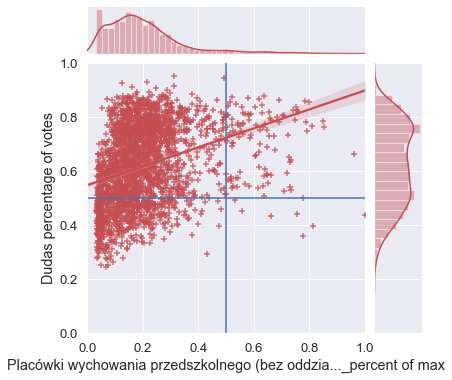

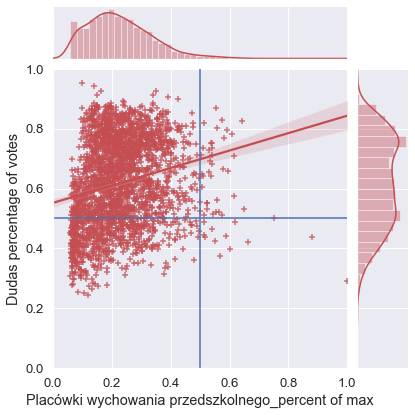

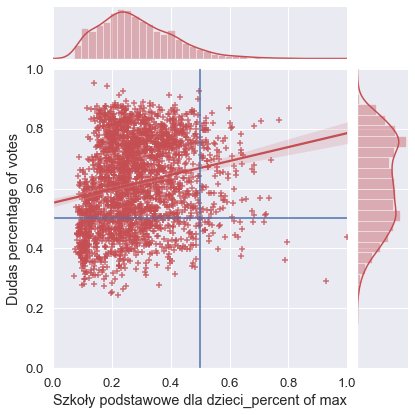

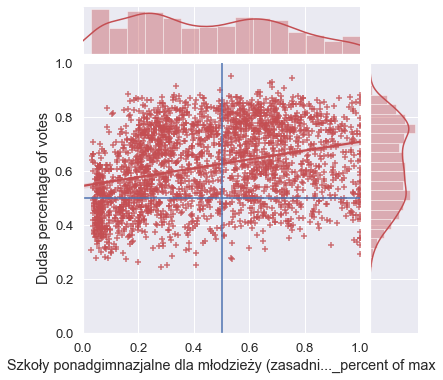

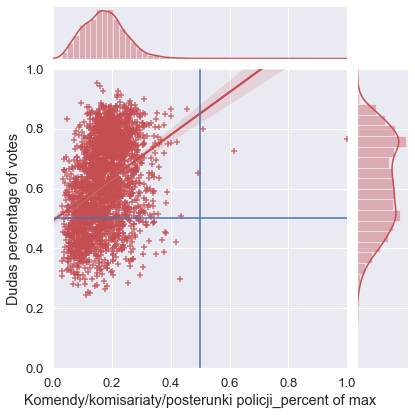

...

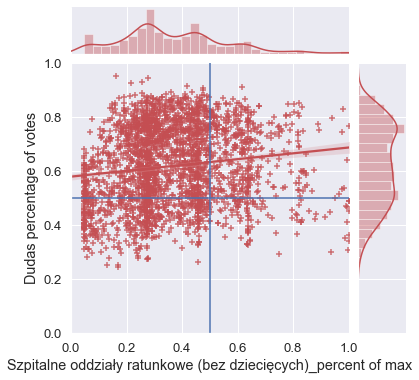

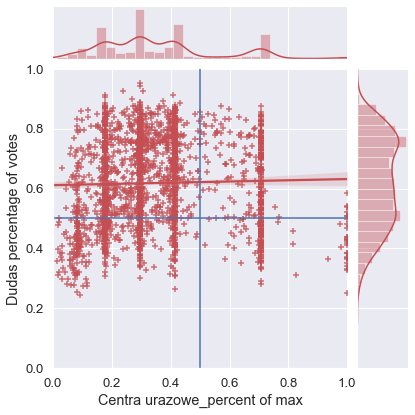

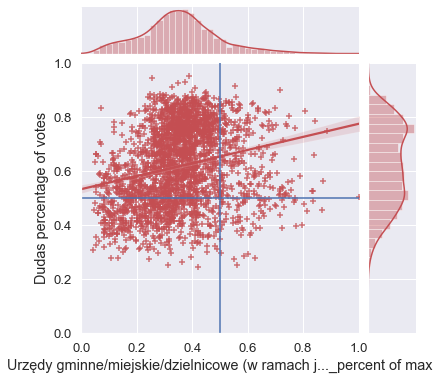

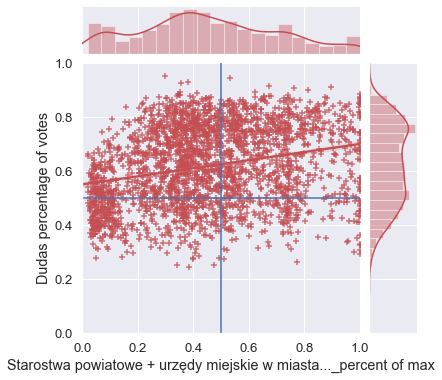

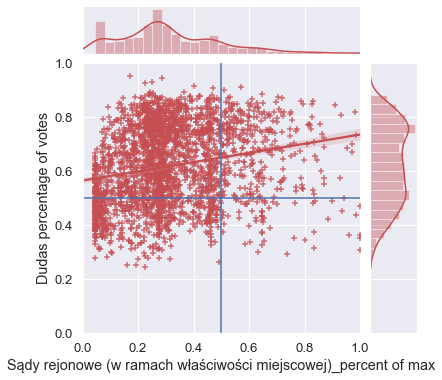

In [104]:
communes_territorial_accessibility_columns = communes_territorial_accessibility.columns.values.tolist()

for i in communes_territorial_accessibility_columns[-20:]:
    plot = sns.jointplot(x=i, y='Dudas percentage of votes', data=communes_territorial_accessibility, kind='reg', marker="+", color="r")
    plot.ax_joint.axhline(y=0.5)
    plot.ax_joint.axvline(x=0.5)
    plot.ax_marg_x.set_xlim(0, 1)
    plot.ax_marg_y.set_ylim(0, 1)
    #sns.jointplot(x=i, y='Trzaskowskis percentage of votes', data=communes_territorial_accessibility, kind='reg', marker="+", color="b")